<a href="https://colab.research.google.com/github/neetmadann/neetmadan.github.io/blob/main/2_Geospatial_Regression_Data_Cleaning_to_Machine_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


# Data Preprocessing, ESDA and Machine Learning Model

## Import All Packages

In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib as plt
import numpy as np
import os 
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn import metrics
from sklearn import ensemble
from sklearn.linear_model import Lasso,Ridge
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor

import osmnx as ox
import plotly
import warnings
warnings.filterwarnings('ignore')


import pandas as pd
import geopandas as gpd
import numpy as np
import os 

import plotly
import plotly.io as pio # to import to show plotly graph
pio.renderers.default='notebook' #import to show plotly graph
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
#sns.set_style("white")
%matplotlib inline


from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn import metrics
from sklearn import ensemble
from sklearn.linear_model import Lasso,Ridge
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor

pd.set_option("display.precision", 4) #Limit display of decimal points

In [ ]:
sns.set_palette("tab10", n_colors=None, desat=None, color_codes=False)

## Area Mapping

In [ ]:
eng_area = pd.read_excel('area_final.xlsx')
eng_area = eng_area.drop(['Unnamed: 0'],axis=1)
#{column: len(eng_area[column].unique()) for column in eng_area.columns}
#eng_area.head()
#eng_area.info(null_counts=True)
eng_area = eng_area.drop({'TCITY15CD','TCITY15NM'},axis=1)

##### Map Data

In [ ]:
MSOA = gpd.read_file('MSOA.geojson')
#MSOA.set_crs('EPSG:27700', allow_override=False)
#MSOA.head()
MSOA = MSOA[MSOA['MSOA11CD'].str[0] =='E']
len(MSOA)

6791

<AxesSubplot: >

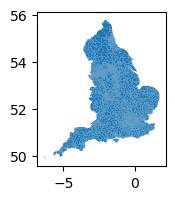

In [ ]:
MSOA.plot(figsize=(2, 2),linewidth=0.01)

## Car ownership Preprocessing
### DFT 2022

In [ ]:
cars = pd.read_csv('car by lsoa.csv',low_memory=False)#specify low memory type false for dtypes of year with mixed data types

cars = cars[cars['LicenceStatus']=='Licensed'] #filter for just licensed cars to be used on roads
cars = cars[cars['BodyType']=='Cars'] #limit to just cars by licensed ownership in England

cars = cars.drop(['BodyType', 'LicenceStatus'],axis=1) #drop unnecessary columns that have been filtered
cars = pd.melt(cars, id_vars=['LSOA11CD', 'LSOA11NM'], var_name='Year-Quarter', value_name='cars') #melt year columns into rows
cars['Year'] = cars['Year-Quarter'].str[0:4] #create Year column
cars['Quarter'] = cars['Year-Quarter'].str[5:7] #create Quarter column
cars = cars[cars['Quarter'].isin(['Q2','Q4'])] #Filter Quarters required
cars = cars.loc[(cars['Year-Quarter'].str.endswith('Q4')) | (cars['Year-Quarter']=='2022 Q2')] #filter for latest data for each year
cars['Year-Quarter'].unique() # check that year quarter chosen is accurate

cols = ['Year', 'cars']
cars[cols] = cars[cols].apply(pd.to_numeric, errors='coerce', axis=1) #change data types for numeric remove errors
cars = cars[['LSOA11CD','LSOA11NM','Year','Quarter','cars']] #keep required columns
cars['Area'] = cars['LSOA11CD'].str[0:2]
cars.loc[cars['LSOA11CD'].str.startswith('E0',na=False),'Country']='England'
cars.loc[cars['LSOA11CD'].str.startswith('95',na=False),'Country'] = 'Northern Ireland'
cars.loc[cars['LSOA11CD'].str.startswith('S0',na=False),'Country'] = 'Scotland'
cars.loc[cars['LSOA11CD'].str.startswith('W0',na=False),'Country'] = 'Wales'
cars.loc[cars['LSOA11CD'].str.startswith('Mi',na=False),'Country'] = 'Other'

##### Exploratory Car Ownership Analysis in United Kingdom, Why we choose England as a Case Study for this research

In [ ]:
yearly = cars[cars['Year']==2022]
yearly = yearly[['Country','cars']] #Car Ownership in 2022 in UK by Country to analyse focus of research
yearly = pd.DataFrame(yearly.groupby('Country').cars.sum()).reset_index() #sum car by country in UK
yearly['Percent'] = [round(i*100/sum(yearly.cars),1) for i in yearly.cars] #proportion of car ownership by country vs UK total
yearly = yearly.astype({'cars':'int'}) 
print('Cars Ownership by Country in UK By % of Total in 2022')
display(yearly)


print('Data Visualization of Car Ownership by Percentage')

yearly = yearly.sort_values(by='cars', ascending=False)
yearly['Y'] = [1]*len(yearly)
list_x = list(range(0,len(yearly)))
yearly['X'] = list_x

#create bubble chart comparison for UK car ownership as proportion of entire UK

#create a label list for each bubble 
label = [i+'<br>'+str(j)+'<br>'+str(k)+'%' for i,j,k in zip(yearly.Country,
                                                            yearly.cars,
                                                            yearly.Percent)]
import plotly.express as px
fig = px.scatter(yearly, x='X', y='Y',color_discrete_sequence=px.colors.sequential.Plasma,
                 color='Country',
                 size='cars', text=label, size_max=90,title="Proportion of Car Ownership in United Kingdom"
                )
fig.update_layout(width=900, height=320,
                  margin = dict(t=50, l=0, r=0, b=0),
                  showlegend=False
                 )
fig.update_traces(textposition='top center')
fig.update_xaxes(showgrid=False, zeroline=False, visible=False)
fig.update_yaxes(showgrid=False, zeroline=False, visible=False)
fig.update_layout({'plot_bgcolor': 'white',
                   'paper_bgcolor': 'white'})
fig.show()

Cars Ownership by Country in UK By % of Total in 2022


,Country,cars,Percent
0,England,27039988,82.2
1,Northern Ireland,999107,3.0
2,Other,745438,2.3
3,Scotland,2532850,7.7
4,Wales,1596939,4.9


Data Visualization of Car Ownership by Percentage


<AxesSubplot: xlabel='Year'>

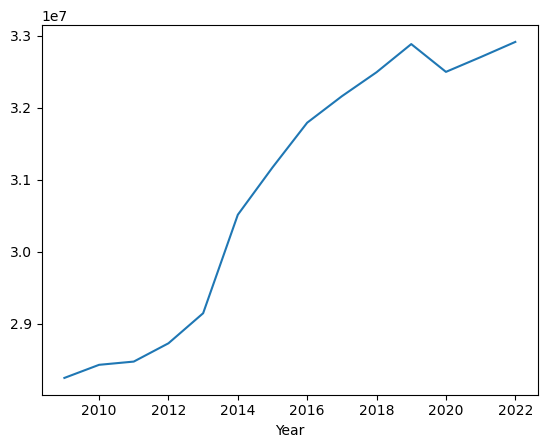

In [ ]:
cars['date'] = pd.to_datetime(dict(year=cars.Year, month=1, day=1))
cars.groupby(['Year']).cars.sum().plot()

Text(0.5, 1.0, 'Car Volume and Year on Year Growth for England')

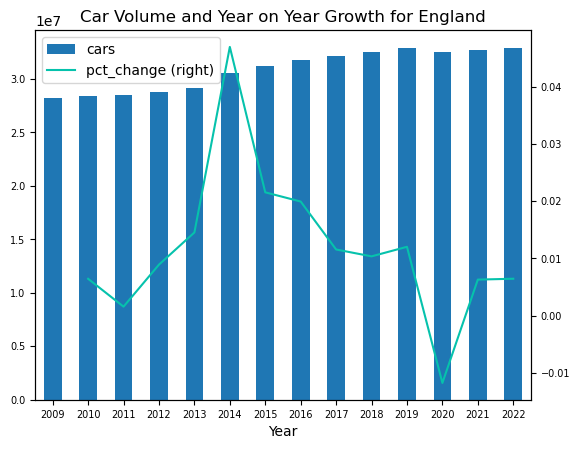

In [ ]:
year = cars[['LSOA11CD','LSOA11NM','Year','cars','Country']] #columns needed for car analysis, to sum by MSOA
year = pd.merge(eng_area[['LSOA11CD','MSOA11CD','MSOA11NM']],year,how='left',on='LSOA11CD')#join car data by LSOA level with MSOA 
year = year[['Country','MSOA11CD','MSOA11NM','Year','cars']]#clean columns 

year = year.groupby(['Country','MSOA11CD','MSOA11NM','Year'])['cars'].agg(['sum']).reset_index() #aggregate by MSOA by Year
year = year.rename({'sum':'cars'},axis=1) #rename sum columns to cars to indicate car volume
year.head(1)

year = cars.groupby(['Year'])['cars'].sum().reset_index() #group car volume by year for England car analysis
year = year.groupby(['Year', 'cars'])['cars'].sum().agg(['pct_change']).reset_index()#add percentage change year on year
year = year.astype({'Year':'int','cars':'int'}) #change data type
#add bar chart with line chart on top for yoy car volume and car volume percentage change analysis for overall England
year[['Year', 'cars']].plot(x='Year',kind='bar', width = 0.5,fontsize=8)
year['pct_change'].plot(secondary_y=True, color='#06C2AC',fontsize=7,legend=True)
plt.title('Car Volume and Year on Year Growth for England')

## Final Car data for Model

In [ ]:
year = 2022 ##Filter 2022 as year for car ownership for this research
cars = cars[cars['Year']==year] #year
cars = cars[cars['LSOA11CD'].str[0]=='E'] #Filter for just England 
cars = cars[cars['Year']==2022] #filter for latest year for car ownership study
cars.head(1)

,LSOA11CD,LSOA11NM,Year,Quarter,cars,Area,Country,date
890,E01000001,City of London 001A,2022.0,Q2,325.0,E0,England,2022-01-01


## Population
### Population 2018 Density

In [ ]:
pop1 = pd.read_excel('population2022.xlsx',sheet_name='Mid-2020 Population Density') #get file for population density year 2018
pop1 = pop1.iloc[3:,] # delete first three rows
pop1.columns = pop1.iloc[0] #use 4th row as header for columns
pop1 = pop1.iloc[1:,] #delete out row that already is a header column
pop1 = pop1.rename({'LSOA Code':'LSOA11CD'},axis=1) #rename columns
pop1 = pop1[pop1['LSOA11CD'].str[0]=='E'] #choose only LSOA from England
cols = ['Mid-2020 population', 'Area Sq Km','People per Sq Km'] # choose columns
pop1[cols] = pop1[cols].apply(pd.to_numeric, errors='coerce', axis=1) #change column dtypes
#pop1.head() #check data output

In [ ]:
age = pd.read_csv('MSOA-age.csv') #read median age by LSOA, we need median age by MSOA so we need to recalculate ourselves
age = age.rename({'MSOA Code':'MSOA11CD'},axis=1) #calculation of Median Age by MSOA was done by excel using frequency by Age bracket formula

In [ ]:
pop = pop1[['LSOA11CD', 'LSOA Name','Mid-2020 population', 'Area Sq Km']]

In [ ]:
pop.head(1)

3,LSOA11CD,LSOA Name,Mid-2020 population,Area Sq Km
4,E01011949,Hartlepool 009A,1944.0,0.5189


## Household
### 2011 Census

In [ ]:
household = pd.read_csv('Household Size 2011.csv') #household count 
household = household[household['geography code'].str[0]=='E']
household = household.rename({'geography code':'LSOA11CD',
                'Household Size: All categories: Household size; measures: Value':'household',
                'Household Size: 1 person in household; measures: Value':'household1',
                 'Household Size: 2 people in household; measures: Value':'household2',
                 'Household Size: 3 people in household; measures: Value':'household3',
                 'Household Size: 4 people in household; measures: Value':'household4',
                 'Household Size: 5 people in household; measures: Value':'household5',
                 'Household Size: 6 people in household; measures: Value':'household6',
                 'Household Size: 7 people in household; measures: Value':'household7',
                 'Household Size: 8 or more people in household; measures: Value':'household8'},axis=1)
household = household[['LSOA11CD','household','household1', 'household2', 'household3', 'household4', 'household5',
       'household6', 'household7', 'household8']] # filter data from  LSOA file
household['household>=3'] = household['household3']+household['household4']+household['household5']+household['household6']+household['household7']+household['household8'] #Household>=3 calculation
household = household[['LSOA11CD','household', 'household1', 'household2','household>=3']] #only household data needed

## Education
### Census 2011 

In [ ]:
education = pd.read_csv('Education.csv') #add government data for Education
education = education[education['geography code'].str[0]=='E'] #choose only MSOA in England and Filter out Wales
education = education.rename({'geography code':'LSOA11CD',
                'Qualification: All categories: Highest level of qualification; measures: Value':'EducationAll',
                'Qualification: No qualifications; measures: Value':'EducationNo',
                 'Qualification: Level 1 qualifications; measures: Value':'Education1',
                 'Qualification: Level 2 qualifications; measures: Value':'Education2',
                 'Qualification: Apprenticeship; measures: Value':'EducationAppren',
                 'Qualification: Level 3 qualifications; measures: Value':'Education3',
                 'Qualification: Level 4 qualifications and above; measures: Value':'Education4',
                 'Qualification: Other qualifications; measures: Value':'EducationOther'},axis=1)
education = education[['LSOA11CD','EducationAll',
       'EducationNo', 'Education1', 'Education2', 'EducationAppren',
       'Education3', 'Education4', 'EducationOther']]

In [ ]:
education.head(1)

,LSOA11CD,EducationAll,EducationNo,Education1,Education2,EducationAppren,Education3,Education4,EducationOther
0,E01012334,1884,241,219,306,89,230,732,67


## Income
### 2018 Revenue

In [ ]:
income = pd.read_excel('income.xls',sheet_name='Total annual income') #Average annual income by MSOA from Gov UK
income = income.iloc[3:,]
income.columns = income.iloc[0]
income = income.iloc[1:,]
income = income[income['MSOA code'].str[0]=='E'] #Filter England MSOAs
income = income.rename({'MSOA code':'MSOA11CD'},axis=1)
income = income [['MSOA11CD','Total annual income (£)']]
income = income.rename({'Total annual income (£)':'income'},axis=1)
income['income'] = income['income'].apply(pd.to_numeric, errors='coerce')

In [ ]:
income.head(1)

3,MSOA11CD,income
4,E02004297,39800


## Public Transport Accessibility

In [ ]:
path = r'C:\Users\neetm\Desktop\Dissertation\Data\public transport data'
filenames = os.listdir(r'C:\Users\neetm\Desktop\Dissertation\Data\public transport data')
pbx = pd.read_csv(path + f'/'+'Public-transport-journey-times-to-all-FE-establishments.csv')
pbx = pbx.iloc[:,0:2]
for f in filenames:
    pb = pd.read_csv(path+f'/'+f)
    pb.rename(columns={pb.columns[2]: f }, inplace = True)
    pbx = pd.merge(pbx,pb.iloc[:, [0,2]],how='left',on='LSOA11 Code')
pbx.head(1)

,LSOA11 Code,LSOA11 Name,Public-transport-journey-times-to-all-FE-establishments.csv,Public-transport-journey-times-to-all-GP-surgeries.csv,Public-transport-journey-times-to-all-hospitals.csv,Public-transport-journey-times-to-all-large-emp-centres.csv,Public-transport-journey-times-to-all-primary-schools.csv,Public-transport-journey-times-to-all-secondary-schools.csv,Public-transport-journey-times-to-all-town-centres.csv,Public-transport-journey-times-to-good-FE-establishments.csv,Public-transport-journey-times-to-good-GP-surgeries.csv,Public-transport-journey-times-to-good-hospitals.csv,Public-transport-journey-times-to-good-primary-schools.csv,Public-transport-journey-times-to-good-secondary-schools.csv
0,E01000001,City of London 001A,10.35,3.96,6.04,3.59,6.12,10.88,16.89,10.35,3.96,6.04,6.12,10.88


In [ ]:
pop2 = pop1[['LSOA11CD','Mid-2020 population']] #Use population data for weighted average by MSOA
pop2 = pop2.rename({'Mid-2020 population':'LSOA_pop'},axis=1)#Use population data for weighted average by MSOA
pb = pd.merge(pop2,pbx,how='left',left_on='LSOA11CD',right_on='LSOA11 Code') #Join with population data
pb = pb[['LSOA11CD', 'LSOA11 Name','LSOA_pop', 
       'Public-transport-journey-times-to-all-FE-establishments.csv',
       'Public-transport-journey-times-to-all-GP-surgeries.csv',
       'Public-transport-journey-times-to-all-hospitals.csv',
       'Public-transport-journey-times-to-all-large-emp-centres.csv',
       'Public-transport-journey-times-to-all-primary-schools.csv',
       'Public-transport-journey-times-to-all-secondary-schools.csv',
       'Public-transport-journey-times-to-all-town-centres.csv',
       'Public-transport-journey-times-to-good-FE-establishments.csv',
       'Public-transport-journey-times-to-good-GP-surgeries.csv',
       'Public-transport-journey-times-to-good-hospitals.csv',
       'Public-transport-journey-times-to-good-primary-schools.csv',
       'Public-transport-journey-times-to-good-secondary-schools.csv']]

####Create Public Journey Times Measure as proxy of Public Transport Accessibility 
### Multiple Average Journey Times Back to Each population for Total Journey Time By Pop
pb['PB_ALLFE'] = pb['Public-transport-journey-times-to-all-FE-establishments.csv'] * pb['LSOA_pop']
pb['PB_ALLGP'] = pb['Public-transport-journey-times-to-all-GP-surgeries.csv'] * pb['LSOA_pop']
pb['PB_ALLHP'] = pb['Public-transport-journey-times-to-all-hospitals.csv'] * pb['LSOA_pop']
pb['PB_ALLEMP'] = pb['Public-transport-journey-times-to-all-large-emp-centres.csv'] * pb['LSOA_pop']
pb['PB_ALLPS'] = pb['Public-transport-journey-times-to-all-primary-schools.csv'] * pb['LSOA_pop']
pb['PB_ALLSS'] = pb['Public-transport-journey-times-to-all-secondary-schools.csv'] * pb['LSOA_pop']
pb['PB_TC'] = pb['Public-transport-journey-times-to-all-town-centres.csv'] * pb['LSOA_pop']
pb['PB_GFE'] = pb['Public-transport-journey-times-to-good-FE-establishments.csv'] * pb['LSOA_pop']
pb['PB_GGP'] = pb['Public-transport-journey-times-to-good-GP-surgeries.csv'] * pb['LSOA_pop']
pb['PB_GHP'] = pb['Public-transport-journey-times-to-good-hospitals.csv'] * pb['LSOA_pop']
pb['PB_GPS'] = pb['Public-transport-journey-times-to-good-primary-schools.csv'] * pb['LSOA_pop']
pb['PB_GSS'] = pb['Public-transport-journey-times-to-good-secondary-schools.csv'] * pb['LSOA_pop']


####Join with MSOA data
pb_msoa = eng_area[['LSOA11CD','MSOA11CD', 'MSOA21CD']]
pb = pd.merge(pb_msoa,pb,how='left',on = 'LSOA11CD')
pbavg = pb[['MSOA11CD', 'MSOA21CD', 'LSOA_pop',
       'PB_ALLFE', 'PB_ALLGP', 'PB_ALLHP', 'PB_ALLEMP', 'PB_ALLPS', 'PB_ALLSS',
       'PB_TC', 'PB_GFE', 'PB_GGP', 'PB_GHP', 'PB_GPS', 'PB_GSS']]
pbavg = pbavg.groupby(by=["MSOA11CD"]).sum().reset_index() #sum all data to MSOA level including population by LSOA

### Weighted Average by Population for Each MSOA
pbavg['PB_ALLFE'] = pbavg['PB_ALLFE']/pbavg['LSOA_pop'] #divide by population by MSOA (LSOA pop was aggregated to MSOA)
pbavg['PB_ALLGP'] = pbavg['PB_ALLGP']/pbavg['LSOA_pop'] #divide by population by MSOA (LSOA pop was aggregated to MSOA)
pbavg['PB_ALLHP'] = pbavg['PB_ALLHP']/pbavg['LSOA_pop']#divide by population by MSOA (LSOA pop was aggregated to MSOA)
pbavg['PB_ALLEMP'] = pbavg['PB_ALLEMP']/pbavg['LSOA_pop']#divide by population by MSOA (LSOA pop was aggregated to MSOA)
pbavg['PB_ALLPS'] = pbavg['PB_ALLPS']/pbavg['LSOA_pop']#divide by population by MSOA (LSOA pop was aggregated to MSOA)
pbavg['PB_ALLSS'] = pbavg['PB_ALLSS']/pbavg['LSOA_pop']#divide by population by MSOA (LSOA pop was aggregated to MSOA)
pbavg['PB_TC'] = pbavg['PB_TC']/pbavg['LSOA_pop']#divide by population by MSOA (LSOA pop was aggregated to MSOA)
pbavg['PB_GFE'] = pbavg['PB_GFE']/pbavg['LSOA_pop']#divide by population by MSOA (LSOA pop was aggregated to MSOA)
pbavg['PB_GGP'] = pbavg['PB_GGP']/pbavg['LSOA_pop']#divide by population by MSOA (LSOA pop was aggregated to MSOA)
pbavg['PB_GHP'] = pbavg['PB_GHP']/pbavg['LSOA_pop']#divide by population by MSOA (LSOA pop was aggregated to MSOA)
pbavg['PB_GPS'] = pbavg['PB_GPS']/pbavg['LSOA_pop']#divide by population by MSOA (LSOA pop was aggregated to MSOA)
pbavg['PB_GSS'] = pbavg['PB_GSS']/pbavg['LSOA_pop']#divide by population by MSOA (LSOA pop was aggregated to MSOA)

public = pbavg[['MSOA11CD','PB_ALLFE', 'PB_ALLGP', 'PB_ALLHP',
       'PB_ALLEMP', 'PB_ALLPS', 'PB_ALLSS', 'PB_TC', 'PB_GFE', 'PB_GGP',
       'PB_GHP', 'PB_GPS', 'PB_GSS']]

In [ ]:
public.head(1)

,MSOA11CD,PB_ALLFE,PB_ALLGP,PB_ALLHP,PB_ALLEMP,PB_ALLPS,PB_ALLSS,PB_TC,PB_GFE,PB_GGP,PB_GHP,PB_GPS,PB_GSS
0,E02000001,10.2763,6.6065,8.9253,4.4551,6.4693,10.5306,16.2894,10.9154,6.6065,9.8408,6.4693,10.9191


## Urban Form:Median

In [ ]:
urban_median = pd.read_csv('urbanmedian.csv') #Momepy Data for Urban Form in Median, details of momepy data in another jupyter notebook
urban_median = urban_median.drop({'Unnamed: 0','geometry'},axis=1)
urban_median = urban_median.rename({'msoa11cd':'MSOA11CD'},axis=1)
urban_median = urban_median[urban_median['MSOA11CD'].str[0]=='E'] #Filtering only England
urban_median = urban_median.drop(['sdbCoA','objectid', 'msoa11nm', 'msoa11nmw', 'st_areasha', 'st_lengths'], axis=1) #dropped columns unused, sdbCoA had 0 values so removed
#drop not needed columns

In [ ]:
urban_median.describe()

,sdbAre,sdbHei,sdbPer,sdbVol,ssbFoF,ssbVFR,ssbCCo,ssbCor,ssbSqu,ssbERI,...,stbSAl,ldbPWL,mtbSWR,sddAre,sdsAre,sisBpM,misCel,mdsAre,lisCel,ldsAre
count,6791.0000,6791.0000,6791.0000,6791.0000,6791.0000,6791.0000,6791.0000,6791.0000,6791.0000,6791.0000,...,6791.0000,6791.0000,6791.0000,6791.0000,6791.0000,6791.0000,6791.0000,6.7910e+03,6791.0000,6.7910e+03
mean,60.4223,7.6969,34.3100,468.7071,1.0590,1.7550,0.5156,5.4990,0.5377,0.9720,...,5.9143,215554.8960,0.9974,23089.1306,37110.8532,0.1831,76.1102,1.3420e+05,270.1636,5.7731e+05
std,10.4045,1.3168,3.3845,133.3931,0.1452,0.1354,0.0466,0.9993,0.4201,0.0215,...,2.6032,150190.6098,0.0080,34983.6121,65441.3674,0.0561,25.6283,2.3665e+05,116.9417,1.0122e+06
min,31.6719,2.7000,23.3780,111.2176,0.6557,1.2588,0.2518,4.0000,0.0075,0.8649,...,0.2973,3882.0328,0.9107,1492.1129,3023.5027,0.0288,22.5164,1.2051e+04,84.7823,4.6341e+04
25%,52.7178,7.0000,32.0845,398.2093,0.9531,1.6642,0.5093,4.0000,0.4006,0.9564,...,3.9589,106575.6599,1.0000,9140.6566,11680.1558,0.1546,58.0745,4.3156e+04,193.0000,1.8567e+05
50%,58.9355,7.6000,34.1377,435.0748,1.0325,1.7403,0.5256,6.0000,0.4868,0.9721,...,6.1751,168434.2749,1.0000,11797.6267,15026.1154,0.1869,71.0000,5.3990e+04,242.0000,2.3481e+05
75%,66.2845,8.2000,36.1821,491.9631,1.1455,1.8402,0.5390,6.0000,0.6110,0.9944,...,7.9550,272902.9595,1.0000,16697.3343,22123.6560,0.2142,87.0320,7.8707e+04,312.0000,3.4544e+05
max,136.2815,23.1000,58.2835,2974.2464,1.7839,2.4657,0.6258,10.0000,13.0068,1.0000,...,21.4417,871384.2142,1.0000,344525.0764,735664.6389,0.9252,267.0000,2.9123e+06,1430.0000,1.2204e+07


In [ ]:
urban_median[urban_median['MSOA11CD']=='E02000001']

,MSOA11CD,sdbAre,sdbHei,sdbPer,sdbVol,ssbFoF,ssbVFR,ssbCCo,ssbCor,ssbSqu,...,stbSAl,ldbPWL,mtbSWR,sddAre,sdsAre,sisBpM,misCel,mdsAre,lisCel,ldsAre
0,E02000001,136.2815,23.1,58.2835,2974.2464,0.7,2.3904,0.4496,6.0,7.6746,...,5.158,38022.0827,1.0,5743.8269,12002.0707,0.1134,29.0,49620.3521,111.1228,227273.3756


## Joining Dataset by LSOA Level

In [ ]:
#join eng geopandas map data with car ownership
df_all = pd.merge(eng_area,cars[['LSOA11CD','cars']],how='left',left_on = 'LSOA11CD',right_on ='LSOA11CD')

#join eng geopandas map data with population data

df_all = pd.merge(df_all,pop[['LSOA11CD','Mid-2020 population', 'Area Sq Km']],
         how='left',left_on = 'LSOA11CD',right_on ='LSOA11CD')

#join eng geopandas map data with household data

df_all = pd.merge(df_all,household[['LSOA11CD','household','household1', 'household2','household>=3']],
         how='left',left_on = 'LSOA11CD',right_on ='LSOA11CD')

#join eng geopandas map data with education data
df_all = pd.merge(df_all,education,
         how='left',left_on = 'LSOA11CD',right_on ='LSOA11CD')

##  Final Data Join by MSOA

In [ ]:
msoa_min = df_all.groupby('MSOA11CD').sum().reset_index() #sum all types of population count from LSOA into MSOA (population sum)
msoa_area = eng_area[['MSOA11CD', 'MSOA11NM','MSOA21CD', 'MSOA21NM', 'LAD22CD', 'LAD22NM', 'CTRY21CD', 'CTRY21NM']]
msoa_area = msoa_area.drop_duplicates(subset=['MSOA11CD', 'MSOA11NM','MSOA21CD', 'MSOA21NM', 'LAD22CD', 'LAD22NM', 'CTRY21CD', 'CTRY21NM'], keep='first')

df = pd.merge(msoa_area,msoa_min,how='left',on='MSOA11CD')
df = pd.merge(df,income,how='left',on='MSOA11CD') #join with income level by MSOA
df = pd.merge(df,urban_median,how='left',on='MSOA11CD') #join with with urban form data by median with MSOA

In [ ]:
df.columns

Index(['MSOA11CD', 'MSOA11NM', 'MSOA21CD', 'MSOA21NM', 'LAD22CD', 'LAD22NM',
       'CTRY21CD', 'CTRY21NM', 'cars', 'Mid-2020 population', 'Area Sq Km',
       'household', 'household1', 'household2', 'household>=3', 'EducationAll',
       'EducationNo', 'Education1', 'Education2', 'EducationAppren',
       'Education3', 'Education4', 'EducationOther', 'income', 'sdbAre',
       'sdbHei', 'sdbPer', 'sdbVol', 'ssbFoF', 'ssbVFR', 'ssbCCo', 'ssbCor',
       'ssbSqu', 'ssbERI', 'ssbElo', 'ssbCCM', 'ssbCCD', 'stbOri', 'sdcLAL',
       'sdcAre', 'sicFAR', 'sscCCo', 'sscERI', 'stcOri', 'sicCAR', 'stbCeA',
       'mtbAli', 'mtbNDi', 'mtcWNe', 'mdcAre', 'ltcWRE', 'ltbIBD', 'ltcRea',
       'ltcAre', 'sdsSPW', 'sdsSPH', 'sdsSPO', 'sdsSWD', 'sdsSHD', 'sdsSPR',
       'sdsLen', 'sssLin', 'ldsMSL', 'mtdDeg', 'lcdMes', 'linP3W', 'linP4W',
       'linPDE', 'lcnClo', 'ldsCDL', 'xcnSCl', 'mtdMDi', 'lddNDe', 'linWID',
       'ldeAre', 'ldePer', 'lseCCo', 'lseERI', 'lseCWA', 'lteOri', 'lteWNB',
       'l

## data map with Map MSOA

In [ ]:
#Map with MSOA map

df_msoa = pd.merge(MSOA,df,how='left',on='MSOA11CD')
df_msoa = pd.merge(df_msoa,age,how='left',on='MSOA11CD') #Map with median age data available at MSOA
df_msoa = pd.merge(df_msoa,public,how='left',on="MSOA11CD") #Map with public transport accessibility dataset

#pd.options.display.max_colwidth = 20 #show entire columns
#df_msoa.head(1)

In [ ]:
df_msoa.head(1)

,OBJECTID,MSOA11CD,MSOA11NM_x,BNG_E,BNG_N,LONG_,LAT,Shape_Leng,Shape__Area,Shape__Length,...,PB_ALLHP,PB_ALLEMP,PB_ALLPS,PB_ALLSS,PB_TC,PB_GFE,PB_GGP,PB_GHP,PB_GPS,PB_GSS
0,1,E02000001,City of London 001,532384,181355,-0.0935,51.5156,9651.2211,3.1515e+06,9651.2211,...,8.9253,4.4551,6.4693,10.5306,16.2894,10.9154,6.6065,9.8408,6.4693,10.9191


In [ ]:
#features = pd.DataFrame(df_msoa.columns.tolist())

## Metrics created

In [ ]:
## Create metrics car by population and population density for use in the model
df_msoa['popdensity'] = round(df_msoa['Mid-2020 population']/df_msoa['Area Sq Km'],2)
df_msoa['car_by_pop'] = round(df_msoa['cars']/df_msoa['Mid-2020 population'],2)
df_msoa['car_by_area'] = round(df_msoa['cars']/df_msoa['Area Sq Km'],2)
df_msoa = df_msoa.rename({'Median':'Age-Median'},axis=1)

In [ ]:
df_msoa.head(1)

,OBJECTID,MSOA11CD,MSOA11NM_x,BNG_E,BNG_N,LONG_,LAT,Shape_Leng,Shape__Area,Shape__Length,...,PB_ALLSS,PB_TC,PB_GFE,PB_GGP,PB_GHP,PB_GPS,PB_GSS,popdensity,car_by_pop,car_by_area
0,1,E02000001,City of London 001,532384,181355,-0.0935,51.5156,9651.2211,3.1515e+06,9651.2211,...,10.5306,16.2894,10.9154,6.6065,9.8408,6.4693,10.9191,3774.59,0.23,852.72


In [ ]:
#drop columns not needed
df_msoa = df_msoa.drop(['BNG_E',
 'BNG_N','Shape_Leng',
 'Shape__Area',
 'Shape__Length',
'MSOA11NM_y',
 'MSOA21CD',
 'MSOA21NM',
 'LAD22CD',
 'LAD22NM',
 'CTRY21CD',
 'CTRY21NM'],axis=1) 

## Final Deal with Null and Nans

In [ ]:
df_msoa[df_msoa.isna().any(axis=1)]

#E02000001 City of London 001
#E02006781	Isles of Scilly 001
#df_msoa['sdbCoA'] check data from column with all 0 values then removed
df_msoa = df_msoa[~df_msoa.isna().any(axis=1)]
#df_msoa = df_msoa.drop(['sdbCoA'],axis=1)

df_msoa[df_msoa.isna().any(axis=1)] #removed two MSOAs that have Urban Form NA values, need to ask Professor Alessandro
#Dask crashes

,OBJECTID,MSOA11CD,MSOA11NM_x,LONG_,LAT,geometry,cars,Mid-2020 population,Area Sq Km,household,...,PB_ALLSS,PB_TC,PB_GFE,PB_GGP,PB_GHP,PB_GPS,PB_GSS,popdensity,car_by_pop,car_by_area


## Data Exploration and Outliers

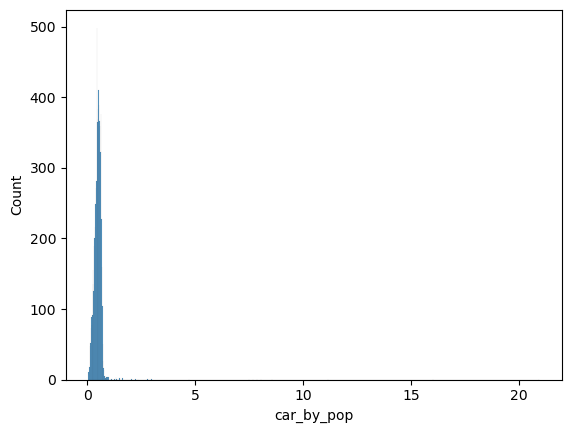

In [ ]:
import seaborn as sns
sns.histplot(df_msoa['car_by_pop'])
import matplotlib.pyplot as plt
plt.show()

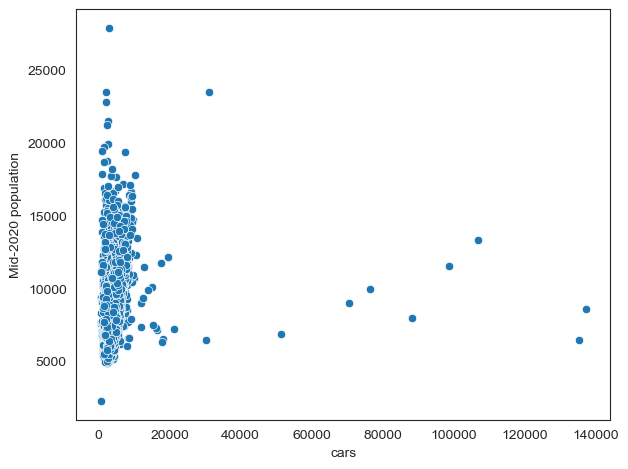

In [ ]:
sns.set_style("white")
from scipy import stats
sns.scatterplot(data=df_msoa, x ='cars', y ='Mid-2020 population')
stats.pearsonr(df_msoa['cars'], df_msoa['Mid-2020 population'])
plt.tight_layout()
plt.show()

PearsonRResult(statistic=0.11294645877365728, pvalue=1.0022144277145983e-20)

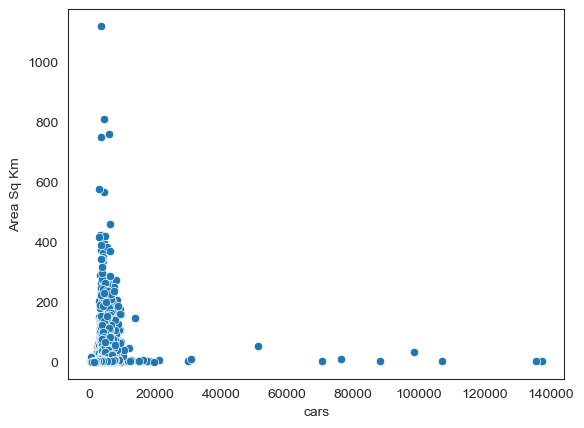

In [ ]:
sns.scatterplot(data=df_msoa, x ='cars', y ='Area Sq Km')
stats.pearsonr(df_msoa['cars'], df_msoa['Area Sq Km'])

<AxesSubplot: xlabel='car_by_pop', ylabel='Area Sq Km'>

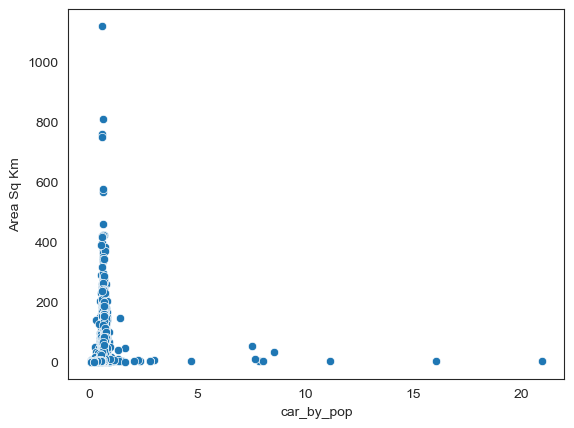

In [ ]:
sns.scatterplot(data=df_msoa, x ='car_by_pop', y ='Area Sq Km') #important

## Outliers
Dealing with Outliers by Imputation, replacing with median values

Like imputation of missing values, we can also impute outliers. We can use mean, median, zero value in this methods. Since we imputing there is no loss of data. Here median is appropriate because it is not affected by outliers.

In [ ]:
df_msoa = df_msoa.rename({'MSOA11NM_x':'MSOA11NM'})

Text(0.5, 1.0, 'Boxplot before dealing with Outliers')

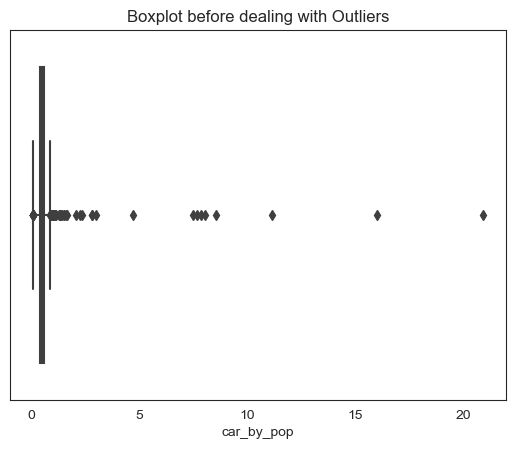

In [ ]:
sns.boxplot(x=df_msoa["car_by_pop"])
plt.title('Boxplot before dealing with Outliers')

In [ ]:
lower_limit = df_msoa["car_by_pop"].quantile(0.01)  
upper_limit = df_msoa["car_by_pop"].quantile(0.99)

print(lower_limit)
print(upper_limit)

0.13
0.77


Text(0.5, 1.0, 'Displot before dealing with Outliers')

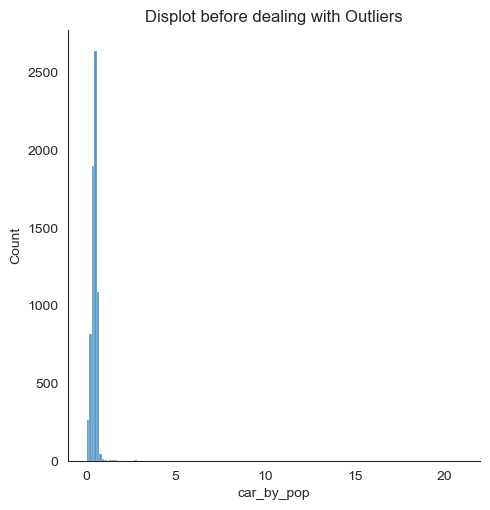

In [ ]:
sns.displot(x=df_msoa["car_by_pop"],bins=150)
plt.title('Displot before dealing with Outliers')

In [ ]:
df_msoa["car_by_pop"] = np.where(df_msoa["car_by_pop"]> upper_limit, upper_limit,
                        np.where(df_msoa["car_by_pop"]< lower_limit, lower_limit,
                        df_msoa["car_by_pop"]))

Text(0.5, 1.0, 'Displot After Dealing with Outliers')

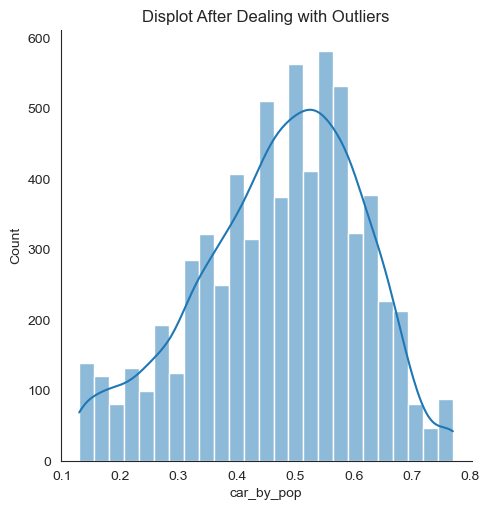

In [ ]:
sns.displot(df_msoa['car_by_pop'], bins=25, kde=True);
plt.title('Displot After Dealing with Outliers')

Text(0.5, 1.0, 'Boxplot After Dealing with Outliers')

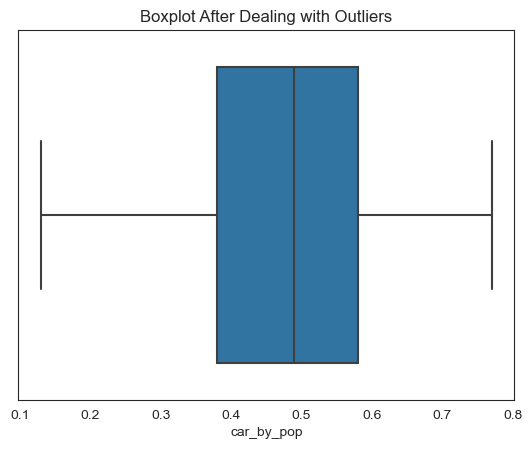

In [ ]:
sns.boxplot(x=df_msoa["car_by_pop"])
plt.title('Boxplot After Dealing with Outliers')

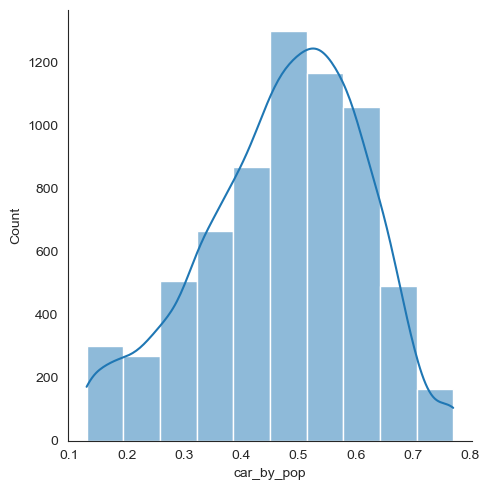

In [ ]:
sns.displot(df_msoa['car_by_pop'], bins=10, kde=True);

Text(0.5, 1.0, 'Car Dependency By Population')

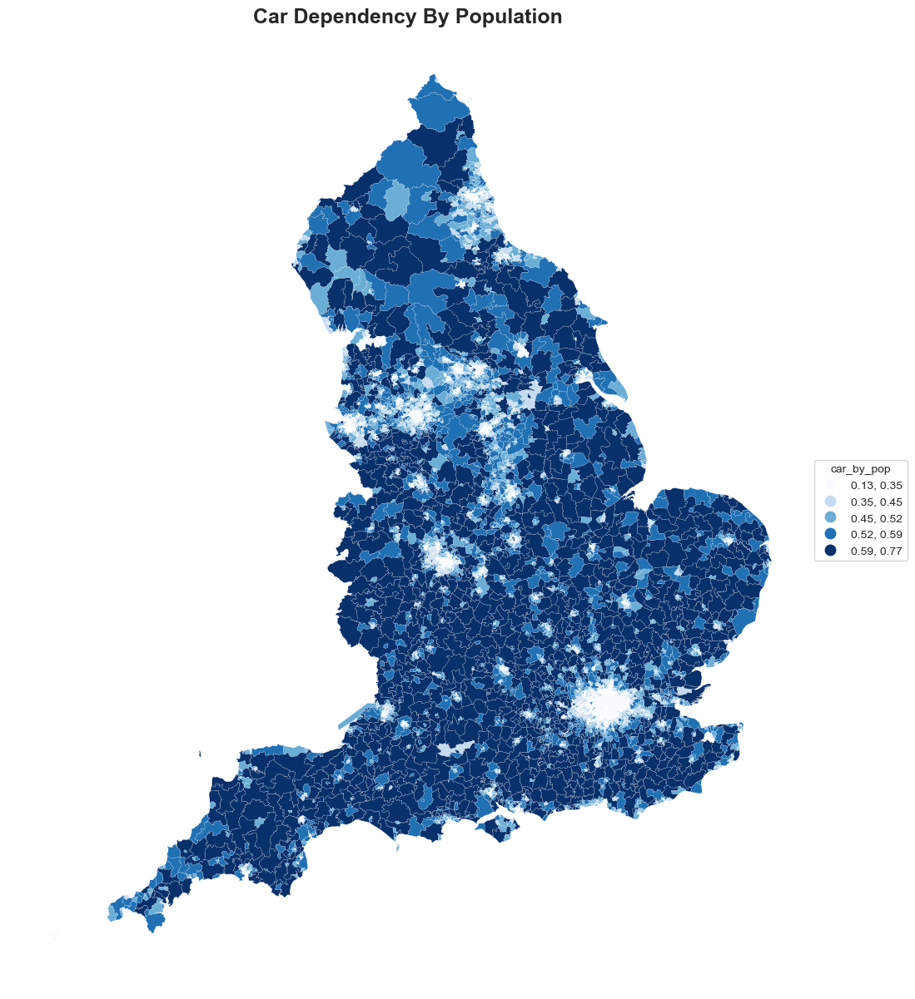

In [ ]:
df_msoa= gpd.GeoDataFrame(df_msoa, geometry='geometry')
car_plot = df_msoa.plot(column = 'car_by_pop', #Assign numerical data column
                      legend = True, #Decide to show legend or not
             legend_kwds={'loc': 'center left','title':'car_by_pop', 'bbox_to_anchor':(1,0.5),'fmt':"{:.2f}"},
                      figsize = [15,15],
                      scheme='quantiles', k=5,linewidth=0.1,cmap = 'Blues')
car_plot.axis('off')
car_plot.set_title('Car Dependency By Population', fontdict={'fontsize': 18, 'fontweight': 'bold'})

In [ ]:
#display(df_msoa.describe().transpose()[['count','mean','std']])

In [ ]:
df_msoa['car_by_pop'].describe()

count    6791.0000
mean        0.4724
std         0.1398
min         0.1300
25%         0.3800
50%         0.4900
75%         0.5800
max         0.7700
Name: car_by_pop, dtype: float64

In [ ]:
df_msoa = pd.DataFrame(df_msoa)

## Further Data Pre-processing and Exploration

In [ ]:
#df_msoa.columns.tolist()

In [ ]:
#create dataframe to explore relationship between all variables and car by pop 
# as population density has been known in literature to be inversely related to car ownership,
#also want to understand its relationship with other explanatory features in isolation
explore_by_pop = df_msoa[[
 'car_by_pop',
    'popdensity',
 'Age-Median',
    'household',
 'household1',
 'household2',
 'household>=3',
 'EducationAll',
 'EducationNo',
 'Education1',
 'Education2',
 'EducationAppren',
 'Education3',
 'Education4',
 'EducationOther',
 'income',
 'PB_ALLFE',
 'PB_ALLGP',
 'PB_ALLHP',
 'PB_ALLEMP',
 'PB_ALLPS',
 'PB_ALLSS',
 'PB_TC',
 'PB_GFE',
 'PB_GGP',
 'PB_GHP',
 'PB_GPS',
 'PB_GSS',
 'sdbAre',
 'sdbHei',
 'sdbPer',
 'sdbVol',
 'ssbFoF',
 'ssbVFR',
 'ssbCCo',
 'ssbCor',
 'ssbSqu',
 'ssbERI',
 'ssbElo',
 'ssbCCM',
 'ssbCCD',
 'stbOri',
 'sdcLAL',
 'sdcAre',
 'sicFAR',
 'sscCCo',
 'sscERI',
 'stcOri',
 'sicCAR',
 'stbCeA',
 'mtbAli',
 'mtbNDi',
 'mtcWNe',
 'mdcAre',
 'ltcWRE',
 'ltbIBD',
 'ltcRea',
 'ltcAre',
 'sdsSPW',
 'sdsSPH',
 'sdsSPO',
 'sdsSWD',
 'sdsSHD',
 'sdsSPR',
 'sdsLen',
 'sssLin',
 'ldsMSL',
 'mtdDeg',
 'lcdMes',
 'linP3W',
 'linP4W',
 'linPDE',
 'lcnClo',
 'ldsCDL',
 'xcnSCl',
 'mtdMDi',
 'lddNDe',
 'linWID',
 'ldeAre',
 'ldePer',
 'lseCCo',
 'lseERI',
 'lseCWA',
 'lteOri',
 'lteWNB',
 'lieWCe',
 'stbSAl',
 'ldbPWL',
 'mtbSWR',
 'sddAre',
 'sdsAre',
 'sisBpM',
 'misCel',
 'mdsAre',
 'lisCel',
 'ldsAre']]

pd.set_option('display.max_columns', None)  # or 1000
pd.set_option('display.max_rows', None)  # or 1000
matrix = pd.DataFrame(explore_by_pop.corr())
display(matrix.head(2))
print(explore_by_pop.shape)

,car_by_pop,popdensity,Age-Median,household,household1,household2,household>=3,EducationAll,EducationNo,Education1,Education2,EducationAppren,Education3,Education4,EducationOther,income,PB_ALLFE,PB_ALLGP,PB_ALLHP,PB_ALLEMP,PB_ALLPS,PB_ALLSS,PB_TC,PB_GFE,PB_GGP,PB_GHP,PB_GPS,PB_GSS,sdbAre,sdbHei,sdbPer,sdbVol,ssbFoF,ssbVFR,ssbCCo,ssbCor,ssbSqu,ssbERI,ssbElo,ssbCCM,ssbCCD,stbOri,sdcLAL,sdcAre,sicFAR,sscCCo,sscERI,stcOri,sicCAR,stbCeA,mtbAli,mtbNDi,mtcWNe,mdcAre,ltcWRE,ltbIBD,ltcRea,ltcAre,sdsSPW,sdsSPH,sdsSPO,sdsSWD,sdsSHD,sdsSPR,sdsLen,sssLin,ldsMSL,mtdDeg,lcdMes,linP3W,linP4W,linPDE,lcnClo,ldsCDL,xcnSCl,mtdMDi,lddNDe,linWID,ldeAre,ldePer,lseCCo,lseERI,lseCWA,lteOri,lteWNB,lieWCe,stbSAl,ldbPWL,mtbSWR,sddAre,sdsAre,sisBpM,misCel,mdsAre,lisCel,ldsAre
car_by_pop,1.0000,-0.7783,0.7761,-0.1666,-0.4297,0.3089,-0.1768,-0.1801,-0.1908,0.0668,0.3124,0.5342,-0.1752,-0.0898,-0.5824,0.2051,0.4978,0.5201,0.5366,0.4912,0.4561,0.4927,0.4939,0.4525,0.5171,0.3701,0.4512,0.4660,0.3096,-0.7118,0.1207,-0.2711,0.7834,0.4813,0.4100,-0.1330,-0.2868,0.2214,0.5145,0.0270,-0.2340,-0.0171,0.5553,0.5991,-0.7489,0.6753,-0.1289,0.0302,-0.7525,0.7902,0.6422,0.7006,-0.4323,0.3660,-0.6508,0.4721,0.4372,0.3643,0.6569,-0.6895,0.6592,0.6212,-0.1817,-0.7164,0.4243,-0.4980,0.3019,-0.0181,-0.6214,-0.2819,-0.5464,0.6453,-0.3744,0.6816,-0.1919,0.4811,-0.4617,-0.6257,0.4770,0.6014,0.1789,-0.2928,0.5702,0.0039,-0.7142,0.0214,0.6509,0.4006,0.3384,0.4584,0.4474,-0.6383,-0.3749,0.4391,-0.4468,0.4255
popdensity,-0.7783,1.0000,-0.5982,0.1362,0.3139,-0.2520,0.1908,0.1612,-0.0336,-0.1594,-0.3351,-0.5218,0.0992,0.2651,0.5894,0.0718,-0.4190,-0.4077,-0.4580,-0.4352,-0.3625,-0.3948,-0.4060,-0.3876,-0.4058,-0.3688,-0.3659,-0.4055,-0.1013,0.7350,0.0833,0.4154,-0.6577,-0.2977,-0.5076,0.1872,0.3149,-0.2855,-0.5686,0.1646,0.3125,0.0088,-0.4397,-0.4711,0.7978,-0.5895,0.0630,-0.0347,0.7665,-0.5922,-0.5403,-0.6221,0.3769,-0.2723,0.6495,-0.3723,-0.4313,-0.2694,-0.6232,0.7383,-0.6321,-0.5788,0.3211,0.7578,-0.3067,0.4541,-0.1820,0.0374,0.5551,0.2530,0.5265,-0.5937,0.3370,-0.5957,0.2475,-0.3613,0.3508,0.5145,-0.3724,-0.4993,-0.1581,0.3184,-0.4805,-0.0134,0.6551,-0.0381,-0.5902,-0.4104,-0.3288,-0.3367,-0.3344,0.5913,0.4112,-0.3322,0.4995,-0.3253


(6791, 96)


In [ ]:
import dataframe_image as dfi
pd.options.display.float_format = '{:,.2f}'.format
data_described = explore_by_pop.describe().transpose()[['count','mean','std','min','max']]#based on results, need to standardscale data
data_described  = data_described.astype({'count':'int'})
dfi.export(data_described, 'data_described.png') #export all data described into png to put in Appendix 
display(data_described) #no null values
#Conclusion we need to standardise the data

,count,mean,std,min,max
car_by_pop,6791,0.47,0.14,0.13,0.77
popdensity,6791,"3,567.99","3,869.24",5.64,"29,452.85"
Age-Median,6791,40.85,7.02,20.00,66.00
household,6791,"3,248.91",683.66,989.00,"6,100.00"
household1,6791,981.67,352.77,249.00,"3,361.00"
household2,6791,"1,110.94",283.31,302.00,"2,455.00"
household>=3,6791,"1,156.31",281.96,190.00,"2,730.00"
EducationAll,6791,"6,330.38","1,310.16","1,857.00","15,522.00"
EducationNo,6791,"1,422.00",537.79,82.00,"3,749.00"
Education1,6791,841.47,244.18,169.00,"2,511.00"


In [ ]:
## Standardise the dataset for exploration purposes
# example of a standardization for ease in exploratory analysis
from numpy import asarray
from sklearn.preprocessing import StandardScaler
# define data
# define standard scaler
scaler = StandardScaler()
# transform data
scaled = scaler.fit_transform(explore_by_pop)
#print(scaled)
colum = explore_by_pop.columns
explore_by_scaled = pd.DataFrame(scaled)
explore_by_scaled.columns = explore_by_pop.columns
explore_by_scaled.head(1)

,car_by_pop,popdensity,Age-Median,household,household1,household2,household>=3,EducationAll,EducationNo,Education1,Education2,EducationAppren,Education3,Education4,EducationOther,income,PB_ALLFE,PB_ALLGP,PB_ALLHP,PB_ALLEMP,PB_ALLPS,PB_ALLSS,PB_TC,PB_GFE,PB_GGP,PB_GHP,PB_GPS,PB_GSS,sdbAre,sdbHei,sdbPer,sdbVol,ssbFoF,ssbVFR,ssbCCo,ssbCor,ssbSqu,ssbERI,ssbElo,ssbCCM,ssbCCD,stbOri,sdcLAL,sdcAre,sicFAR,sscCCo,sscERI,stcOri,sicCAR,stbCeA,mtbAli,mtbNDi,mtcWNe,mdcAre,ltcWRE,ltbIBD,ltcRea,ltcAre,sdsSPW,sdsSPH,sdsSPO,sdsSWD,sdsSHD,sdsSPR,sdsLen,sssLin,ldsMSL,mtdDeg,lcdMes,linP3W,linP4W,linPDE,lcnClo,ldsCDL,xcnSCl,mtdMDi,lddNDe,linWID,ldeAre,ldePer,lseCCo,lseERI,lseCWA,lteOri,lteWNB,lieWCe,stbSAl,ldbPWL,mtbSWR,sddAre,sdsAre,sisBpM,misCel,mdsAre,lisCel,ldsAre
0,-1.73,0.05,-0.83,1.66,4.22,0.87,-2.13,0.32,-1.80,-2.25,-2.14,-1.78,-0.74,3.34,0.24,2.21,-0.66,-0.52,-1.34,-1.25,-0.38,-0.49,-0.08,-0.86,-0.54,-1.55,-0.45,-0.62,7.29,11.70,7.08,18.78,-2.47,4.69,-1.42,0.50,16.99,-0.53,-0.79,8.79,1.81,-0.77,-0.51,-0.22,12.28,2.78,-0.24,-0.94,4.90,-0.75,0.87,-2.05,-0.36,0.17,0.13,-0.63,2.77,-0.13,-2.64,13.55,-1.24,-1.14,11.71,14.58,-0.90,0.83,-0.48,-0.02,1.29,1.60,0.80,-1.67,0.04,-1.58,-0.15,-0.92,1.20,1.71,-0.54,-0.92,1.19,0.35,-0.96,-0.85,1.91,-0.22,-0.29,-1.18,0.32,-0.50,-0.38,-1.24,-1.84,-0.36,-1.36,-0.35


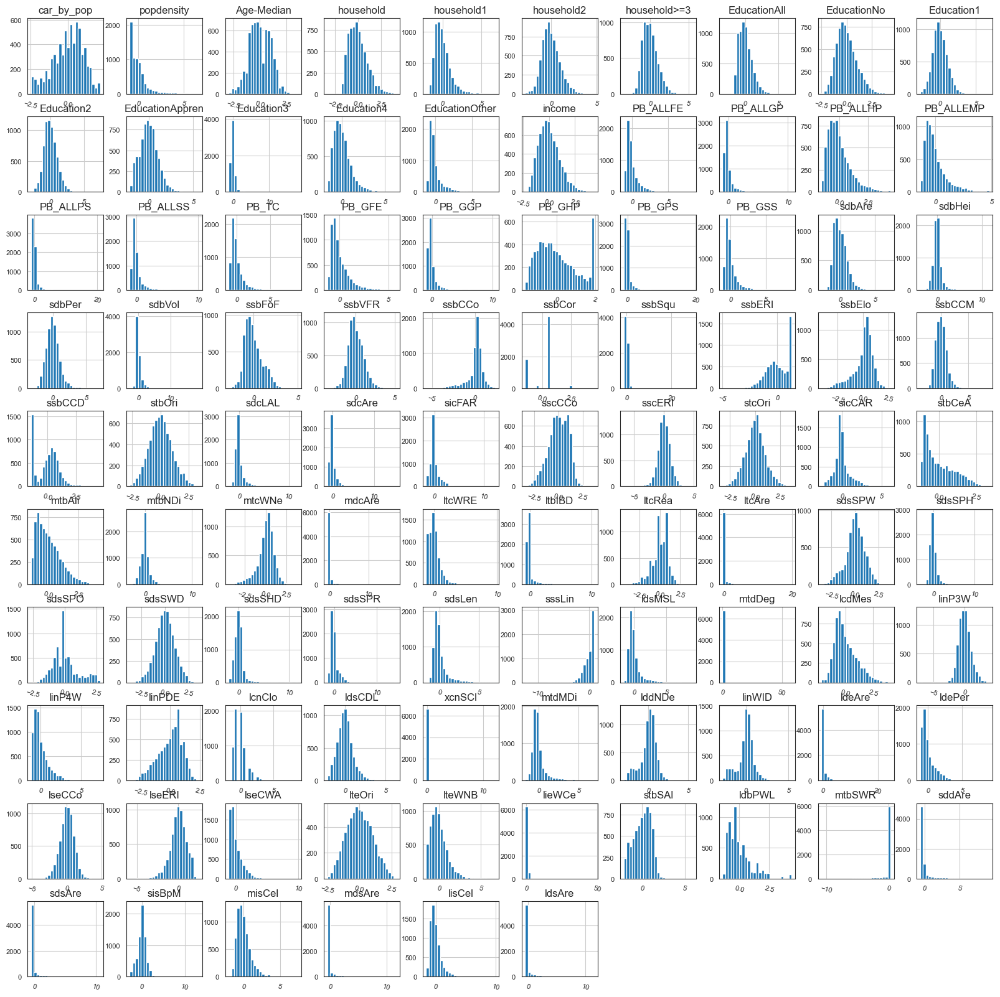

In [ ]:
sns.set_style("white")
explore_by_scaled.hist(bins=25,figsize=(20,20),xlabelsize='8',ylabelsize='8',xrot=-15)
plt.title('Histogram for every feature')
plt.show()

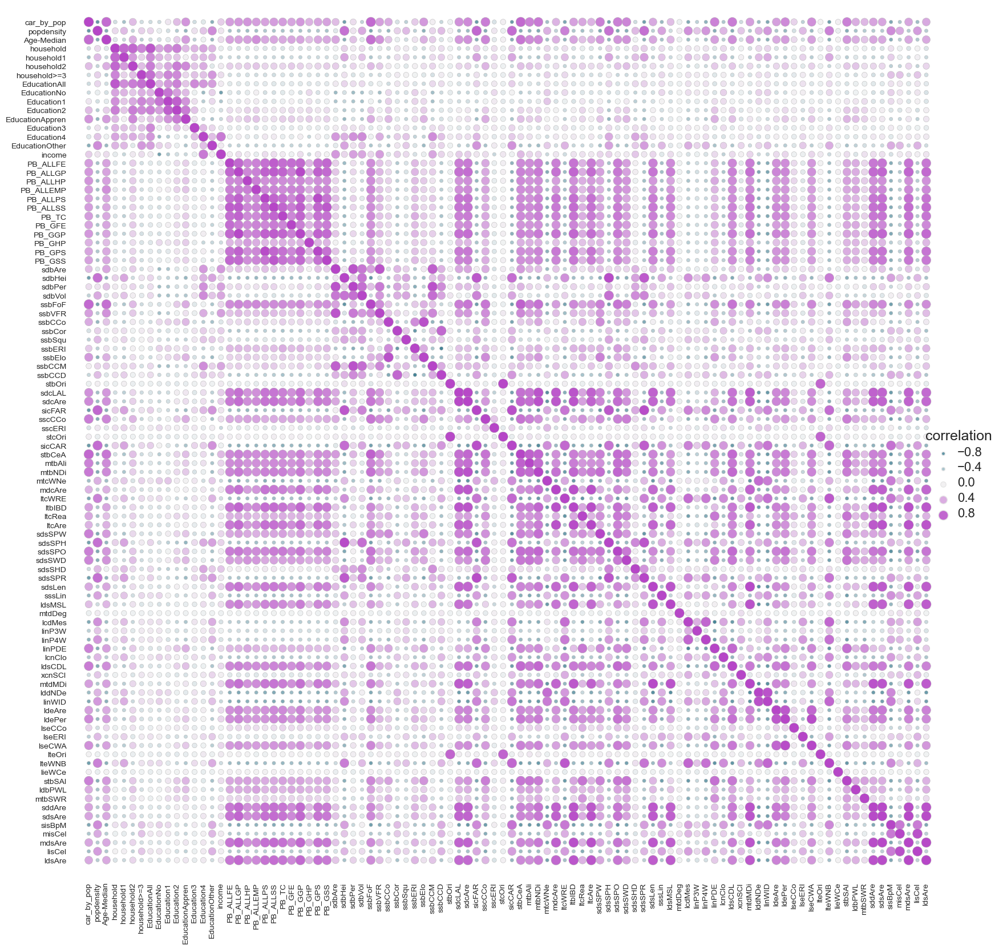

In [ ]:
# Compute a correlation matrix and convert to long-form
corr_mat = explore_by_scaled.corr().stack().reset_index(name="correlation")

cmap=sns.diverging_palette(220,300,s=75, l=50, sep=1, n=6, as_cmap=True,center='light')
# Draw each cell as a scatter point with varying size and color
g = sns.relplot(
    data=corr_mat,
    x="level_0", y="level_1", hue="correlation", size="correlation",
    palette=cmap, hue_norm=(-1, 1), edgecolor=".7",
    height=17, sizes=(20, 150), size_norm=(-0.2, 0.8),legend=True)

# Tweak the figure to finalize
g.set(xlabel="", ylabel="", aspect="equal")
g.despine(left=True, bottom=True)
g.ax.margins(.02)
g.legend.get_title().set_fontsize(18)
for label in g.ax.get_xticklabels():
    label.set_rotation(90)
for artist in g.legend.legendHandles:
    artist.set_edgecolor(".9")
for text in g.legend.texts:
    text.set_fontsize(16)

In [ ]:
explore_by_scaled.corr(method='pearson').round(2) #table with all scores to check features, exploratory analysis 

,car_by_pop,popdensity,Age-Median,household,household1,household2,household>=3,EducationAll,EducationNo,Education1,Education2,EducationAppren,Education3,Education4,EducationOther,income,PB_ALLFE,PB_ALLGP,PB_ALLHP,PB_ALLEMP,PB_ALLPS,PB_ALLSS,PB_TC,PB_GFE,PB_GGP,PB_GHP,PB_GPS,PB_GSS,sdbAre,sdbHei,sdbPer,sdbVol,ssbFoF,ssbVFR,ssbCCo,ssbCor,ssbSqu,ssbERI,ssbElo,ssbCCM,ssbCCD,stbOri,sdcLAL,sdcAre,sicFAR,sscCCo,sscERI,stcOri,sicCAR,stbCeA,mtbAli,mtbNDi,mtcWNe,mdcAre,ltcWRE,ltbIBD,ltcRea,ltcAre,sdsSPW,sdsSPH,sdsSPO,sdsSWD,sdsSHD,sdsSPR,sdsLen,sssLin,ldsMSL,mtdDeg,lcdMes,linP3W,linP4W,linPDE,lcnClo,ldsCDL,xcnSCl,mtdMDi,lddNDe,linWID,ldeAre,ldePer,lseCCo,lseERI,lseCWA,lteOri,lteWNB,lieWCe,stbSAl,ldbPWL,mtbSWR,sddAre,sdsAre,sisBpM,misCel,mdsAre,lisCel,ldsAre
car_by_pop,1.00,-0.78,0.78,-0.17,-0.43,0.31,-0.18,-0.18,-0.19,0.07,0.31,0.53,-0.18,-0.09,-0.58,0.21,0.50,0.52,0.54,0.49,0.46,0.49,0.49,0.45,0.52,0.37,0.45,0.47,0.31,-0.71,0.12,-0.27,0.78,0.48,0.41,-0.13,-0.29,0.22,0.51,0.03,-0.23,-0.02,0.56,0.60,-0.75,0.68,-0.13,0.03,-0.75,0.79,0.64,0.70,-0.43,0.37,-0.65,0.47,0.44,0.36,0.66,-0.69,0.66,0.62,-0.18,-0.72,0.42,-0.50,0.30,-0.02,-0.62,-0.28,-0.55,0.65,-0.37,0.68,-0.19,0.48,-0.46,-0.63,0.48,0.60,0.18,-0.29,0.57,0.00,-0.71,0.02,0.65,0.40,0.34,0.46,0.45,-0.64,-0.37,0.44,-0.45,0.43
popdensity,-0.78,1.00,-0.60,0.14,0.31,-0.25,0.19,0.16,-0.03,-0.16,-0.34,-0.52,0.10,0.27,0.59,0.07,-0.42,-0.41,-0.46,-0.44,-0.36,-0.39,-0.41,-0.39,-0.41,-0.37,-0.37,-0.41,-0.10,0.74,0.08,0.42,-0.66,-0.30,-0.51,0.19,0.31,-0.29,-0.57,0.16,0.31,0.01,-0.44,-0.47,0.80,-0.59,0.06,-0.03,0.77,-0.59,-0.54,-0.62,0.38,-0.27,0.65,-0.37,-0.43,-0.27,-0.62,0.74,-0.63,-0.58,0.32,0.76,-0.31,0.45,-0.18,0.04,0.56,0.25,0.53,-0.59,0.34,-0.60,0.25,-0.36,0.35,0.51,-0.37,-0.50,-0.16,0.32,-0.48,-0.01,0.66,-0.04,-0.59,-0.41,-0.33,-0.34,-0.33,0.59,0.41,-0.33,0.50,-0.33
Age-Median,0.78,-0.60,1.00,-0.10,-0.24,0.38,-0.32,-0.18,-0.14,-0.06,0.20,0.50,-0.28,-0.02,-0.50,0.12,0.46,0.45,0.48,0.57,0.43,0.44,0.42,0.44,0.45,0.30,0.42,0.43,0.44,-0.57,0.28,-0.09,0.75,0.55,0.26,-0.04,-0.17,0.09,0.38,0.21,-0.11,-0.03,0.52,0.56,-0.57,0.62,-0.08,0.01,-0.59,0.71,0.59,0.60,-0.44,0.37,-0.52,0.45,0.29,0.37,0.51,-0.52,0.53,0.54,-0.02,-0.54,0.43,-0.42,0.34,-0.02,-0.46,-0.20,-0.40,0.48,-0.33,0.58,-0.15,0.47,-0.47,-0.57,0.41,0.49,0.13,-0.19,0.46,-0.01,-0.58,0.00,0.51,0.40,0.26,0.43,0.43,-0.59,-0.32,0.43,-0.36,0.42
household,-0.17,0.14,-0.10,1.00,0.80,0.80,0.63,0.90,0.45,0.56,0.66,0.32,0.36,0.45,0.35,-0.05,-0.10,-0.12,-0.10,-0.07,-0.10,-0.11,-0.13,-0.07,-0.12,-0.11,-0.10,-0.08,-0.01,0.18,0.05,0.12,-0.14,-0.07,-0.15,0.07,0.05,-0.10,-0.17,0.08,0.11,-0.02,-0.17,-0.16,0.21,-0.05,0.11,-0.03,0.21,-0.16,-0.12,-0.20,0.15,-0.11,0.11,-0.13,-0.05,-0.11,-0.19,0.19,-0.12,-0.07,0.15,0.21,-0.14,0.12,-0.12,-0.01,0.09,0.04,0.08,-0.11,0.14,-0.14,-0.01,-0.15,0.14,0.16,-0.12,-0.14,-0.02,0.08,-0.14,-0.03,0.16,-0.05,-0.12,-0.01,-0.04,-0.13,-0.12,0.09,-0.02,-0.12,0.01,-0.11
household1,-0.43,0.31,-0.24,0.80,1.00,0.50,0.17,0.59,0.36,0.25,0.26,0.02,0.27,0.32,0.33,-0.23,-0.22,-0.26,-0.25,-0.20,-0.21,-0.22,-0.28,-0.19,-0.26,-0.20,-0.20,-0.19,-0.06,0.43,0.07,0.27,-0.37,-0.18,-0.29,0.12,0.17,-0.20,-0.33,0.14,0.20,0.01,-0.29,-0.29,0.47,-0.19,0.17,-0.01,0.44,-0.38,-0.27,-0.39,0.23,-0.18,0.30,-0.23,-0.14,-0.18,-0.38,0.45,-0.26,-0.21,0.30,0.47,-0.27,0.26,-0.21,-0.01,0.30,0.12,0.28,-0.32,0.32,-0.33,0.01,-0.30,0.31,0.39,-0.26,-0.33,-0.05,0.18,-0.32,-0.01,0.43,-0.06,-0.32,-0.09,-0.18,-0.25,-0.23,0.20,-0.04,-0.22,0.02,-0.21
household2,0.31,-0.25,0.38,0.80,0.50,1.00,0.30,0.68,0.25,0.43,0.68,0.60,0.25,0.40,-0.08,0.05,0.20,0.19,0.21,0.25,0.17,0.18,0.17,0.22,0.19,0.11,0.17,0.21,0.20,-0.19,0.16,0.03,0.32,0.23,0.05,-0.01,-0.09,0.01,0.10,0.16,-0.01,-0.03,0.16,0.19,-0.17,0.35,0.08,-0.01,-0.20,0.29,0.26,0.20,-0.12,0.12,-0.24,0.15,0.18,0.13,0.14,-0.15,0.25,0.29,0.14,-0.14,0.12,-0.18,0.09,-0.01,-0.23,-0.08,-0.21,0.22,-0.08,0.24,-0.11,0.14,-0.15,-0.20,0.16,0.21,0.08,-0.08,0.19,-0.03,-0.23,-0.04,0.24,0.26,0.12,0.15,0.15,-0.30,-0.25,0.16,-0.26,0.16
household>=3,-0.18,0.1

## See all Scatterplots of all 95 Features with Car by Pop

Total Features are : 95


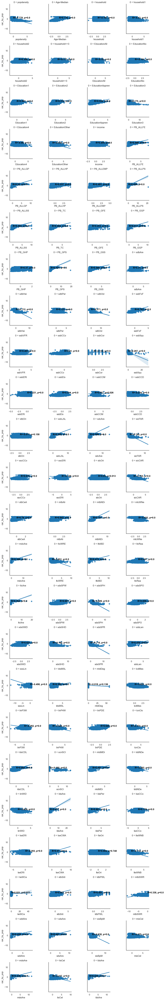

In [ ]:
sns.set_theme(style="white", palette=None)
#MissingAccess to Public Transport
from scipy import stats
x_vars= ['popdensity',
 'Age-Median',
    'household',
 'household1',
 'household2',
 'household>=3',
 'EducationAll',
 'EducationNo',
 'Education1',
 'Education2',
 'EducationAppren',
 'Education3',
 'Education4',
 'EducationOther',
 'income',
 'PB_ALLFE',
 'PB_ALLGP',
 'PB_ALLHP',
 'PB_ALLEMP',
 'PB_ALLPS',
 'PB_ALLSS',
 'PB_TC',
 'PB_GFE',
 'PB_GGP',
 'PB_GHP',
 'PB_GPS',
 'PB_GSS',
 'sdbAre',
 'sdbHei',
 'sdbPer',
 'sdbVol',
 'ssbFoF',
 'ssbVFR',
 'ssbCCo',
 'ssbCor',
 'ssbSqu',
 'ssbERI',
 'ssbElo',
 'ssbCCM',
 'ssbCCD',
 'stbOri',
 'sdcLAL',
 'sdcAre',
 'sicFAR',
 'sscCCo',
 'sscERI',
 'stcOri',
 'sicCAR',
 'stbCeA',
 'mtbAli',
 'mtbNDi',
 'mtcWNe',
 'mdcAre',
 'ltcWRE',
 'ltbIBD',
 'ltcRea',
 'ltcAre',
 'sdsSPW',
 'sdsSPH',
 'sdsSPO',
 'sdsSWD',
 'sdsSHD',
 'sdsSPR',
 'sdsLen',
 'sssLin',
 'ldsMSL',
 'mtdDeg',
 'lcdMes',
 'linP3W',
 'linP4W',
 'linPDE',
 'lcnClo',
 'ldsCDL',
 'xcnSCl',
 'mtdMDi',
 'lddNDe',
 'linWID',
 'ldeAre',
 'ldePer',
 'lseCCo',
 'lseERI',
 'lseCWA',
 'lteOri',
 'lteWNB',
 'lieWCe',
 'stbSAl',
 'ldbPWL',
 'mtbSWR',
 'sddAre',
 'sdsAre',
 'sisBpM',
 'misCel',
 'mdsAre',
 'lisCel',
 'ldsAre'
]
print('Total Features are :',len(x_vars))        
y_vars='car_by_pop'


g = sns.FacetGrid(pd.DataFrame(x_vars), col=0, col_wrap=4, sharex=False)

for ax, x_var in zip(g.axes, x_vars):
        sns.regplot(data=explore_by_scaled, x=x_var, y=y_vars,ax=ax)
        r, p = round(stats.pearsonr(explore_by_scaled[y_vars], explore_by_scaled[x_var])[0],3),round(stats.pearsonr(explore_by_scaled[y_vars], explore_by_scaled[x_var])[1],3)
        ax.text(0, 0, "R={}, p={}".format(r,p), horizontalalignment='left', 
            verticalalignment='bottom',size='medium', color='black', weight='semibold')

g.tight_layout()
#for i in range(len(x_vars)):
 #   print('car_by_pop with ' + x_vars[i])
  #  print(stats.pearsonr(explore_by_scaled[y_vars], explore_by_scaled[x_vars[i]]))

# Filter only Features with High Absolute Value (Pos, Neg) Correlation >0.5 

In [ ]:
#filter only features with higher correlation towards car by pop than 0.5 
filter_corr = explore_by_scaled.corr(method='pearson').round(2)
filter_corr = filter_corr[abs(filter_corr['car_by_pop'])>=0.5]
filter_corr[abs(filter_corr['car_by_pop'])>=0.5].index.tolist()
selected_feature_esda = filter_corr.loc[:,filter_corr.columns.isin(filter_corr[abs(filter_corr['car_by_pop'])>=0.5].index.tolist())]
selected_feature_list = selected_feature_esda.index.tolist()
display(filter_corr[abs(filter_corr['car_by_pop'])>=0.5])

,car_by_pop,popdensity,Age-Median,household,household1,household2,household>=3,EducationAll,EducationNo,Education1,Education2,EducationAppren,Education3,Education4,EducationOther,income,PB_ALLFE,PB_ALLGP,PB_ALLHP,PB_ALLEMP,PB_ALLPS,PB_ALLSS,PB_TC,PB_GFE,PB_GGP,PB_GHP,PB_GPS,PB_GSS,sdbAre,sdbHei,sdbPer,sdbVol,ssbFoF,ssbVFR,ssbCCo,ssbCor,ssbSqu,ssbERI,ssbElo,ssbCCM,ssbCCD,stbOri,sdcLAL,sdcAre,sicFAR,sscCCo,sscERI,stcOri,sicCAR,stbCeA,mtbAli,mtbNDi,mtcWNe,mdcAre,ltcWRE,ltbIBD,ltcRea,ltcAre,sdsSPW,sdsSPH,sdsSPO,sdsSWD,sdsSHD,sdsSPR,sdsLen,sssLin,ldsMSL,mtdDeg,lcdMes,linP3W,linP4W,linPDE,lcnClo,ldsCDL,xcnSCl,mtdMDi,lddNDe,linWID,ldeAre,ldePer,lseCCo,lseERI,lseCWA,lteOri,lteWNB,lieWCe,stbSAl,ldbPWL,mtbSWR,sddAre,sdsAre,sisBpM,misCel,mdsAre,lisCel,ldsAre
car_by_pop,1.00,-0.78,0.78,-0.17,-0.43,0.31,-0.18,-0.18,-0.19,0.07,0.31,0.53,-0.18,-0.09,-0.58,0.21,0.50,0.52,0.54,0.49,0.46,0.49,0.49,0.45,0.52,0.37,0.45,0.47,0.31,-0.71,0.12,-0.27,0.78,0.48,0.41,-0.13,-0.29,0.22,0.51,0.03,-0.23,-0.02,0.56,0.60,-0.75,0.68,-0.13,0.03,-0.75,0.79,0.64,0.70,-0.43,0.37,-0.65,0.47,0.44,0.36,0.66,-0.69,0.66,0.62,-0.18,-0.72,0.42,-0.50,0.30,-0.02,-0.62,-0.28,-0.55,0.65,-0.37,0.68,-0.19,0.48,-0.46,-0.63,0.48,0.60,0.18,-0.29,0.57,0.00,-0.71,0.02,0.65,0.40,0.34,0.46,0.45,-0.64,-0.37,0.44,-0.45,0.43
popdensity,-0.78,1.00,-0.60,0.14,0.31,-0.25,0.19,0.16,-0.03,-0.16,-0.34,-0.52,0.10,0.27,0.59,0.07,-0.42,-0.41,-0.46,-0.44,-0.36,-0.39,-0.41,-0.39,-0.41,-0.37,-0.37,-0.41,-0.10,0.74,0.08,0.42,-0.66,-0.30,-0.51,0.19,0.31,-0.29,-0.57,0.16,0.31,0.01,-0.44,-0.47,0.80,-0.59,0.06,-0.03,0.77,-0.59,-0.54,-0.62,0.38,-0.27,0.65,-0.37,-0.43,-0.27,-0.62,0.74,-0.63,-0.58,0.32,0.76,-0.31,0.45,-0.18,0.04,0.56,0.25,0.53,-0.59,0.34,-0.60,0.25,-0.36,0.35,0.51,-0.37,-0.50,-0.16,0.32,-0.48,-0.01,0.66,-0.04,-0.59,-0.41,-0.33,-0.34,-0.33,0.59,0.41,-0.33,0.50,-0.33
Age-Median,0.78,-0.60,1.00,-0.10,-0.24,0.38,-0.32,-0.18,-0.14,-0.06,0.20,0.50,-0.28,-0.02,-0.50,0.12,0.46,0.45,0.48,0.57,0.43,0.44,0.42,0.44,0.45,0.30,0.42,0.43,0.44,-0.57,0.28,-0.09,0.75,0.55,0.26,-0.04,-0.17,0.09,0.38,0.21,-0.11,-0.03,0.52,0.56,-0.57,0.62,-0.08,0.01,-0.59,0.71,0.59,0.60,-0.44,0.37,-0.52,0.45,0.29,0.37,0.51,-0.52,0.53,0.54,-0.02,-0.54,0.43,-0.42,0.34,-0.02,-0.46,-0.20,-0.40,0.48,-0.33,0.58,-0.15,0.47,-0.47,-0.57,0.41,0.49,0.13,-0.19,0.46,-0.01,-0.58,0.00,0.51,0.40,0.26,0.43,0.43,-0.59,-0.32,0.43,-0.36,0.42
EducationAppren,0.53,-0.52,0.50,0.32,0.02,0.60,0.15,0.26,0.32,0.54,0.68,1.00,0.08,-0.21,-0.38,-0.21,0.19,0.15,0.25,0.26,0.10,0.12,0.21,0.22,0.15,0.21,0.11,0.18,-0.04,-0.51,-0.15,-0.36,0.40,0.09,0.33,-0.06,-0.27,0.13,0.35,-0.23,-0.14,-0.05,0.06,0.11,-0.47,0.40,0.07,-0.03,-0.39,0.29,0.22,0.23,0.00,0.02,-0.29,0.06,0.16,0.02,0.26,-0.52,0.26,0.33,-0.24,-0.48,0.03,-0.24,-0.04,-0.01,-0.37,-0.16,-0.35,0.38,-0.05,0.29,-0.13,0.06,-0.07,-0.19,0.14,0.24,0.07,-0.24,0.24,-0.04,-0.36,0.02,0.34,0.29,0.19,0.07,0.06,-0.24,-0.22,0.06,-0.27,0.07
EducationOther,-0.58,0.59,-0.50,0.35,0.33,-0.08,0.52,0.48,0.19,0.14,-0.03,-0.38,0.16,0.29,1.00,0.05,-0.27,-0.26,-0.30,-0.28,-0.20,-0.24,-0.26,-0.24,-0.25,-0.24,-0.20,-0.25,-0.06,0.45,0.09,0.26,-0.39,-0.22,-0.42,0.07,0.23,-0.12,-0.48,0.18,0.17,-0.01,-0.28,-0.31,0.54,-0.41,0.04,-0.03,0.55,-0.40,-0.40,-0.45,0.22,-0.17,0.36,-0.24,-0.22,-0.16,-0.41,0.46,-0.40,-0.40,0.23,0.49,-0.15,0.33,-0.08,-0.01,0.39,0.17,0.35,-0.40,0.19,-0.38,0.16,-0.19,0.17,0.29,-0.24,-0.32,-0.11,0.23,-0.31,-0.02,0.41,-0.02,-0.42,-0.28,-0.15,-0.20,-0.20,0.41,0.33,-0.19,0.36,-0.19
PB_ALLFE,0.50,-0.42,0.46,-0.10,-0.22,0.20,-0.17,-0.08,-0.09,-0.04,0.11,0.19,-0.06,-0.02,-0.27,0.03,1.00,0.80,0.60,0.64,0.75,0.86,0.76,0.77,0.80,0.34,0.75,0.80,0.19,-0.47,0.10,-0.17,0.59,0.27,0.13,-0.35,-0.13,0.33,0.17,0.16,-0.34,-0.02,0.67,0.69,-0.47,0.42,-0.04,0.02,-0.54,0.61,0.59,0.64,-0.55,0.66,-0.44,0.73,0.36,0.69,0.42,-0.41,0.67,0.48,0.01,-0.38,0.65,-0.44,0.59,-0.01,-0.30,-0.18,-0.24,0.34,-0.36,0.61,-0.08,0.67,-0.57,-0.60,0.57,0.58,0.13,-0.08,0.52,0.00,-0.47,0.02,0.44,0.40,0.15,0.71,0.72,-0.60,-0.35,0.72,-0.35,0.71
PB_ALLGP,0.52,-0.41,0.45,-

In [ ]:
display(filter_corr)

,car_by_pop,popdensity,Age-Median,household,household1,household2,household>=3,EducationAll,EducationNo,Education1,Education2,EducationAppren,Education3,Education4,EducationOther,income,PB_ALLFE,PB_ALLGP,PB_ALLHP,PB_ALLEMP,PB_ALLPS,PB_ALLSS,PB_TC,PB_GFE,PB_GGP,PB_GHP,PB_GPS,PB_GSS,sdbAre,sdbHei,sdbPer,sdbVol,ssbFoF,ssbVFR,ssbCCo,ssbCor,ssbSqu,ssbERI,ssbElo,ssbCCM,ssbCCD,stbOri,sdcLAL,sdcAre,sicFAR,sscCCo,sscERI,stcOri,sicCAR,stbCeA,mtbAli,mtbNDi,mtcWNe,mdcAre,ltcWRE,ltbIBD,ltcRea,ltcAre,sdsSPW,sdsSPH,sdsSPO,sdsSWD,sdsSHD,sdsSPR,sdsLen,sssLin,ldsMSL,mtdDeg,lcdMes,linP3W,linP4W,linPDE,lcnClo,ldsCDL,xcnSCl,mtdMDi,lddNDe,linWID,ldeAre,ldePer,lseCCo,lseERI,lseCWA,lteOri,lteWNB,lieWCe,stbSAl,ldbPWL,mtbSWR,sddAre,sdsAre,sisBpM,misCel,mdsAre,lisCel,ldsAre
car_by_pop,1.00,-0.78,0.78,-0.17,-0.43,0.31,-0.18,-0.18,-0.19,0.07,0.31,0.53,-0.18,-0.09,-0.58,0.21,0.50,0.52,0.54,0.49,0.46,0.49,0.49,0.45,0.52,0.37,0.45,0.47,0.31,-0.71,0.12,-0.27,0.78,0.48,0.41,-0.13,-0.29,0.22,0.51,0.03,-0.23,-0.02,0.56,0.60,-0.75,0.68,-0.13,0.03,-0.75,0.79,0.64,0.70,-0.43,0.37,-0.65,0.47,0.44,0.36,0.66,-0.69,0.66,0.62,-0.18,-0.72,0.42,-0.50,0.30,-0.02,-0.62,-0.28,-0.55,0.65,-0.37,0.68,-0.19,0.48,-0.46,-0.63,0.48,0.60,0.18,-0.29,0.57,0.00,-0.71,0.02,0.65,0.40,0.34,0.46,0.45,-0.64,-0.37,0.44,-0.45,0.43
popdensity,-0.78,1.00,-0.60,0.14,0.31,-0.25,0.19,0.16,-0.03,-0.16,-0.34,-0.52,0.10,0.27,0.59,0.07,-0.42,-0.41,-0.46,-0.44,-0.36,-0.39,-0.41,-0.39,-0.41,-0.37,-0.37,-0.41,-0.10,0.74,0.08,0.42,-0.66,-0.30,-0.51,0.19,0.31,-0.29,-0.57,0.16,0.31,0.01,-0.44,-0.47,0.80,-0.59,0.06,-0.03,0.77,-0.59,-0.54,-0.62,0.38,-0.27,0.65,-0.37,-0.43,-0.27,-0.62,0.74,-0.63,-0.58,0.32,0.76,-0.31,0.45,-0.18,0.04,0.56,0.25,0.53,-0.59,0.34,-0.60,0.25,-0.36,0.35,0.51,-0.37,-0.50,-0.16,0.32,-0.48,-0.01,0.66,-0.04,-0.59,-0.41,-0.33,-0.34,-0.33,0.59,0.41,-0.33,0.50,-0.33
Age-Median,0.78,-0.60,1.00,-0.10,-0.24,0.38,-0.32,-0.18,-0.14,-0.06,0.20,0.50,-0.28,-0.02,-0.50,0.12,0.46,0.45,0.48,0.57,0.43,0.44,0.42,0.44,0.45,0.30,0.42,0.43,0.44,-0.57,0.28,-0.09,0.75,0.55,0.26,-0.04,-0.17,0.09,0.38,0.21,-0.11,-0.03,0.52,0.56,-0.57,0.62,-0.08,0.01,-0.59,0.71,0.59,0.60,-0.44,0.37,-0.52,0.45,0.29,0.37,0.51,-0.52,0.53,0.54,-0.02,-0.54,0.43,-0.42,0.34,-0.02,-0.46,-0.20,-0.40,0.48,-0.33,0.58,-0.15,0.47,-0.47,-0.57,0.41,0.49,0.13,-0.19,0.46,-0.01,-0.58,0.00,0.51,0.40,0.26,0.43,0.43,-0.59,-0.32,0.43,-0.36,0.42
EducationAppren,0.53,-0.52,0.50,0.32,0.02,0.60,0.15,0.26,0.32,0.54,0.68,1.00,0.08,-0.21,-0.38,-0.21,0.19,0.15,0.25,0.26,0.10,0.12,0.21,0.22,0.15,0.21,0.11,0.18,-0.04,-0.51,-0.15,-0.36,0.40,0.09,0.33,-0.06,-0.27,0.13,0.35,-0.23,-0.14,-0.05,0.06,0.11,-0.47,0.40,0.07,-0.03,-0.39,0.29,0.22,0.23,0.00,0.02,-0.29,0.06,0.16,0.02,0.26,-0.52,0.26,0.33,-0.24,-0.48,0.03,-0.24,-0.04,-0.01,-0.37,-0.16,-0.35,0.38,-0.05,0.29,-0.13,0.06,-0.07,-0.19,0.14,0.24,0.07,-0.24,0.24,-0.04,-0.36,0.02,0.34,0.29,0.19,0.07,0.06,-0.24,-0.22,0.06,-0.27,0.07
EducationOther,-0.58,0.59,-0.50,0.35,0.33,-0.08,0.52,0.48,0.19,0.14,-0.03,-0.38,0.16,0.29,1.00,0.05,-0.27,-0.26,-0.30,-0.28,-0.20,-0.24,-0.26,-0.24,-0.25,-0.24,-0.20,-0.25,-0.06,0.45,0.09,0.26,-0.39,-0.22,-0.42,0.07,0.23,-0.12,-0.48,0.18,0.17,-0.01,-0.28,-0.31,0.54,-0.41,0.04,-0.03,0.55,-0.40,-0.40,-0.45,0.22,-0.17,0.36,-0.24,-0.22,-0.16,-0.41,0.46,-0.40,-0.40,0.23,0.49,-0.15,0.33,-0.08,-0.01,0.39,0.17,0.35,-0.40,0.19,-0.38,0.16,-0.19,0.17,0.29,-0.24,-0.32,-0.11,0.23,-0.31,-0.02,0.41,-0.02,-0.42,-0.28,-0.15,-0.20,-0.20,0.41,0.33,-0.19,0.36,-0.19
PB_ALLFE,0.50,-0.42,0.46,-0.10,-0.22,0.20,-0.17,-0.08,-0.09,-0.04,0.11,0.19,-0.06,-0.02,-0.27,0.03,1.00,0.80,0.60,0.64,0.75,0.86,0.76,0.77,0.80,0.34,0.75,0.80,0.19,-0.47,0.10,-0.17,0.59,0.27,0.13,-0.35,-0.13,0.33,0.17,0.16,-0.34,-0.02,0.67,0.69,-0.47,0.42,-0.04,0.02,-0.54,0.61,0.59,0.64,-0.55,0.66,-0.44,0.73,0.36,0.69,0.42,-0.41,0.67,0.48,0.01,-0.38,0.65,-0.44,0.59,-0.01,-0.30,-0.18,-0.24,0.34,-0.36,0.61,-0.08,0.67,-0.57,-0.60,0.57,0.58,0.13,-0.08,0.52,0.00,-0.47,0.02,0.44,0.40,0.15,0.71,0.72,-0.60,-0.35,0.72,-0.35,0.71
PB_ALLGP,0.52,-0.41,0.45,-

In [ ]:
pd.options.display.float_format = "{:,.6f}".format
#display pvalue for all correlation matrix
#check p-value of features with correlation with car ownership higher than 0.5 absolute value could be negative or positive
#select features in a list for further observation on ESDA (Exploratory Data Analysis for only those features)
from scipy.stats import pearsonr

def corr_pval(df):
    corr_pval_df = pd.DataFrame(index=df.columns, columns=df.columns)
    for i in range(len(corr_pval_df.index)):
        for c in range(len(corr_pval_df.columns)):
            corr_pval_df.iloc[i, c] = round(pearsonr(df[corr_pval_df.index[i]], df[corr_pval_df.columns[c]])[1],6)
    return corr_pval_df
        
pvalue_corr = corr_pval(explore_by_scaled)
display(pvalue_corr) 
selected_feature_esda = pvalue_corr.loc[pvalue_corr.index.isin(selected_feature_list),pvalue_corr.columns.isin(selected_feature_list)]
selected_feature_esda
esda_selectedfeatures = selected_feature_esda.index.tolist()

,car_by_pop,popdensity,Age-Median,household,household1,household2,household>=3,EducationAll,EducationNo,Education1,Education2,EducationAppren,Education3,Education4,EducationOther,income,PB_ALLFE,PB_ALLGP,PB_ALLHP,PB_ALLEMP,PB_ALLPS,PB_ALLSS,PB_TC,PB_GFE,PB_GGP,PB_GHP,PB_GPS,PB_GSS,sdbAre,sdbHei,sdbPer,sdbVol,ssbFoF,ssbVFR,ssbCCo,ssbCor,ssbSqu,ssbERI,ssbElo,ssbCCM,ssbCCD,stbOri,sdcLAL,sdcAre,sicFAR,sscCCo,sscERI,stcOri,sicCAR,stbCeA,mtbAli,mtbNDi,mtcWNe,mdcAre,ltcWRE,ltbIBD,ltcRea,ltcAre,sdsSPW,sdsSPH,sdsSPO,sdsSWD,sdsSHD,sdsSPR,sdsLen,sssLin,ldsMSL,mtdDeg,lcdMes,linP3W,linP4W,linPDE,lcnClo,ldsCDL,xcnSCl,mtdMDi,lddNDe,linWID,ldeAre,ldePer,lseCCo,lseERI,lseCWA,lteOri,lteWNB,lieWCe,stbSAl,ldbPWL,mtbSWR,sddAre,sdsAre,sisBpM,misCel,mdsAre,lisCel,ldsAre
car_by_pop,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.026357,0.000000,0.157901,0.000000,0.000000,0.000000,0.000000,0.000000,0.012846,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.136069,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.748248,0.000000,0.077214,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
popdensity,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.005631,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.468222,0.000000,0.000000,0.000000,0.000000,0.000000,0.004267,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.002078,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.271130,0.000000,0.001690,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Age-Median,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.176318,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000290,0.000000,0.000000,0.000000,0.000000,0.000000,0.019090,0.000000,0.000000,0.000000,0.000000,0.000000,0.278604,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.199656,0.000000,0.000000,0.000000,0.000000,0.092319,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.391347,0.000000,0.751439,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
household,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000102,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.291491,0.000000,0.000014,0.000000,0.000000,0.000000,0.000000,0.000000,0.000008,0.000000,0.000000,0.000000,0.000000,0.171985,0.000000,0.000000,0.000000,0.000112,0.000000,0.024971,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000052,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.23

In [ ]:
esda_selectedfeatures #all features with absolute value correlation higher than 0.5 and significant pvalue

['car_by_pop',
 'popdensity',
 'Age-Median',
 'EducationAppren',
 'EducationOther',
 'PB_ALLFE',
 'PB_ALLGP',
 'PB_ALLHP',
 'PB_GGP',
 'sdbHei',
 'ssbFoF',
 'ssbElo',
 'sdcLAL',
 'sdcAre',
 'sicFAR',
 'sscCCo',
 'sicCAR',
 'stbCeA',
 'mtbAli',
 'mtbNDi',
 'ltcWRE',
 'sdsSPW',
 'sdsSPH',
 'sdsSPO',
 'sdsSWD',
 'sdsSPR',
 'sssLin',
 'lcdMes',
 'linP4W',
 'linPDE',
 'ldsCDL',
 'linWID',
 'ldePer',
 'lseCWA',
 'lteWNB',
 'stbSAl',
 'sisBpM']

In [ ]:
len(['Age-Median',
 'popdensity',
 'household',
 'household1',
 'household2',
 'household>=3',
 'EducationAll',
 'EducationNo',
 'Education1',
 'Education2',
 'EducationAppren',
 'Education3',
 'Education4',
 'EducationOther',
 'income',
'PB_ALLFE',
 'PB_ALLGP',
 'PB_ALLHP',
 'PB_ALLEMP',
 'PB_ALLPS',
 'PB_ALLSS',
 'PB_TC',
 'PB_GFE',
 'PB_GGP',
 'PB_GHP',
 'PB_GPS',
 'PB_GSS',
'sdbAre',
 'sdbHei',
 'sdbPer',
 'sdbVol',
 'ssbFoF',
 'ssbVFR',
 'ssbCCo',
 'ssbCor',
 'ssbSqu',
 'ssbERI',
 'ssbElo',
 'ssbCCM',
 'ssbCCD',
 'stbOri',
 'sdcLAL',
 'sdcAre',
 'sicFAR',
 'sscCCo',
 'sscERI',
 'stcOri',
 'sicCAR',
 'stbCeA',
 'mtbAli',
 'mtbNDi',
 'mtcWNe',
 'mdcAre',
 'ltcWRE',
 'ltbIBD',
 'ltcRea',
 'ltcAre',
 'sdsSPW',
 'sdsSPH',
 'sdsSPO',
 'sdsSWD',
 'sdsSHD',
 'sdsSPR',
 'sdsLen',
 'sssLin',
 'ldsMSL',
 'mtdDeg',
 'lcdMes',
 'linP3W',
 'linP4W',
 'linPDE',
 'lcnClo',
 'ldsCDL',
 'xcnSCl',
 'mtdMDi',
 'lddNDe',
 'linWID',
 'ldeAre',
 'ldePer',
 'lseCCo',
 'lseERI',
 'lseCWA',
 'lteOri',
 'lteWNB',
 'lieWCe',
 'stbSAl',
 'ldbPWL',
 'mtbSWR',
 'sddAre',
 'sdsAre',
 'sisBpM',
 'misCel',
 'mdsAre',
 'lisCel',
 'ldsAre'])

95

## Exploratory Spatial Data Analysis (Choropleth Map) ESDA of highly Correlated Features with Car Ownership

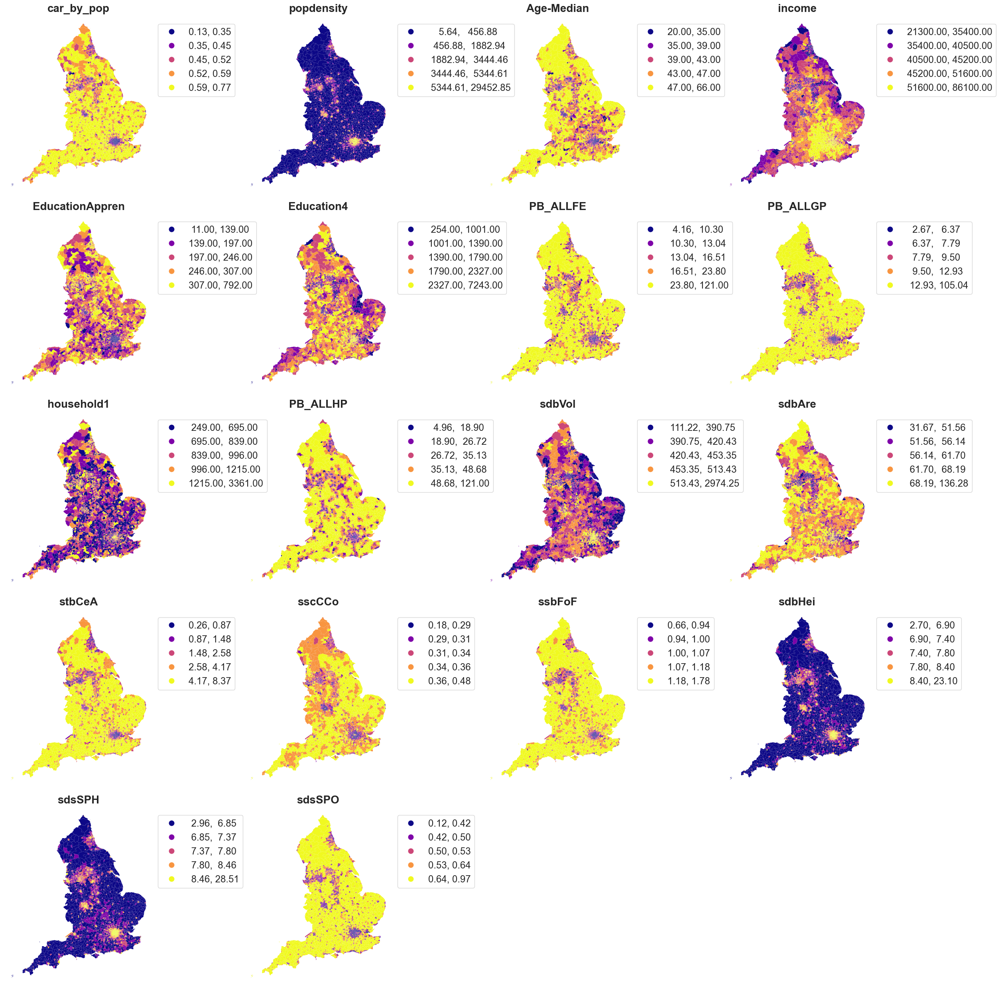

In [ ]:
df_msoa= gpd.GeoDataFrame(df_msoa, geometry='geometry')
p_vars= ['car_by_pop',
 'popdensity',
 'Age-Median',
  'income',
 'EducationAppren',
 'Education4',
 'PB_ALLFE',
 'PB_ALLGP',
'household1',
 'PB_ALLHP','sdbVol','sdbAre',
'stbCeA','sscCCo',
'ssbFoF',
'sdbHei','sdsSPH','sdsSPO']
         
         
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec

n_plots = len(p_vars)
# compute the number of rows and columns
n_cols =  int(np.sqrt(n_plots))
n_rows = int(np.ceil(n_plots / n_cols))

# setup the plot
gs = gridspec.GridSpec(n_rows, n_cols)
scale = max(n_cols, n_rows)
fig = plt.figure(figsize=(5 * scale, 5 * scale))

# loop through each subplot and plot values there
for i in range(n_plots):
    ax = fig.add_subplot(gs[i])
    df_msoa.plot(column = p_vars[i],ax=ax,legend=True,legend_kwds={'loc': 'center left', 'bbox_to_anchor':(1,0.5,0.5, 0.5),'fmt':"{:.2f}",'fontsize':'x-large'}, scheme='quantiles', cmap='plasma', linewidth=0.01,)
    ax.set_title(p_vars[i], fontdict={'fontsize': 20, 'fontweight': 'bold'})
    ax.axis('off')
gs.tight_layout(fig, rect=[0, 0, 1.0, 1.0])

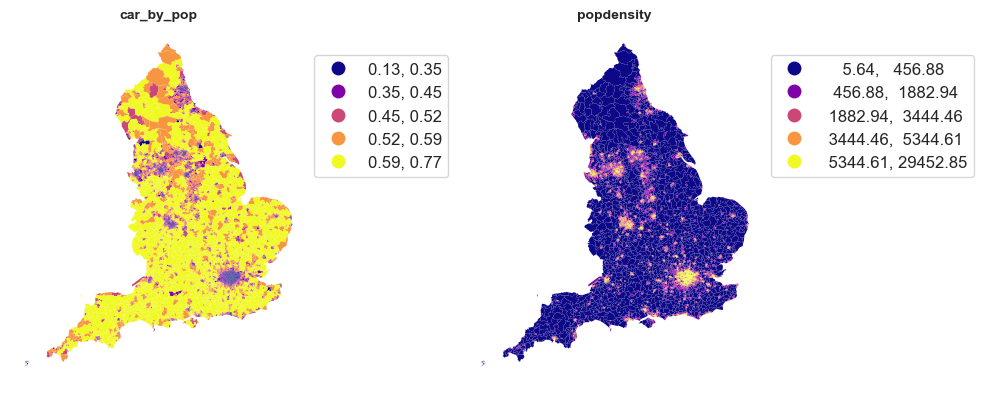

In [ ]:
df_msoa= gpd.GeoDataFrame(df_msoa, geometry='geometry')
p_vars= ['car_by_pop',
 'popdensity']
         
         
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec

n_plots = len(p_vars)
# compute the number of rows and columns
n_cols =  2 #nt(np.sqrt(n_plots))
n_rows = int(np.ceil(n_plots / n_cols))

# setup the plot
gs = gridspec.GridSpec(n_rows, n_cols)
scale = max(n_cols, n_rows)
fig = plt.figure(figsize=(5 * scale, 5 * scale))

# loop through each subplot and plot values there
for i in range(n_plots):
    ax = fig.add_subplot(gs[i])
    df_msoa.plot(column = p_vars[i],ax=ax,legend=True,legend_kwds={'loc': 'center left', 'bbox_to_anchor':(1,0.5,0.5, 0.5),'fmt':"{:.2f}",'fontsize':'medium'}, scheme='quantiles', cmap='plasma', linewidth=0.01,)
    ax.set_title(p_vars[i], fontdict={'fontsize': 10, 'fontweight': 'bold'})
    ax.axis('off')
gs.tight_layout(fig, rect=[0, 0, 1.0, 1.0])

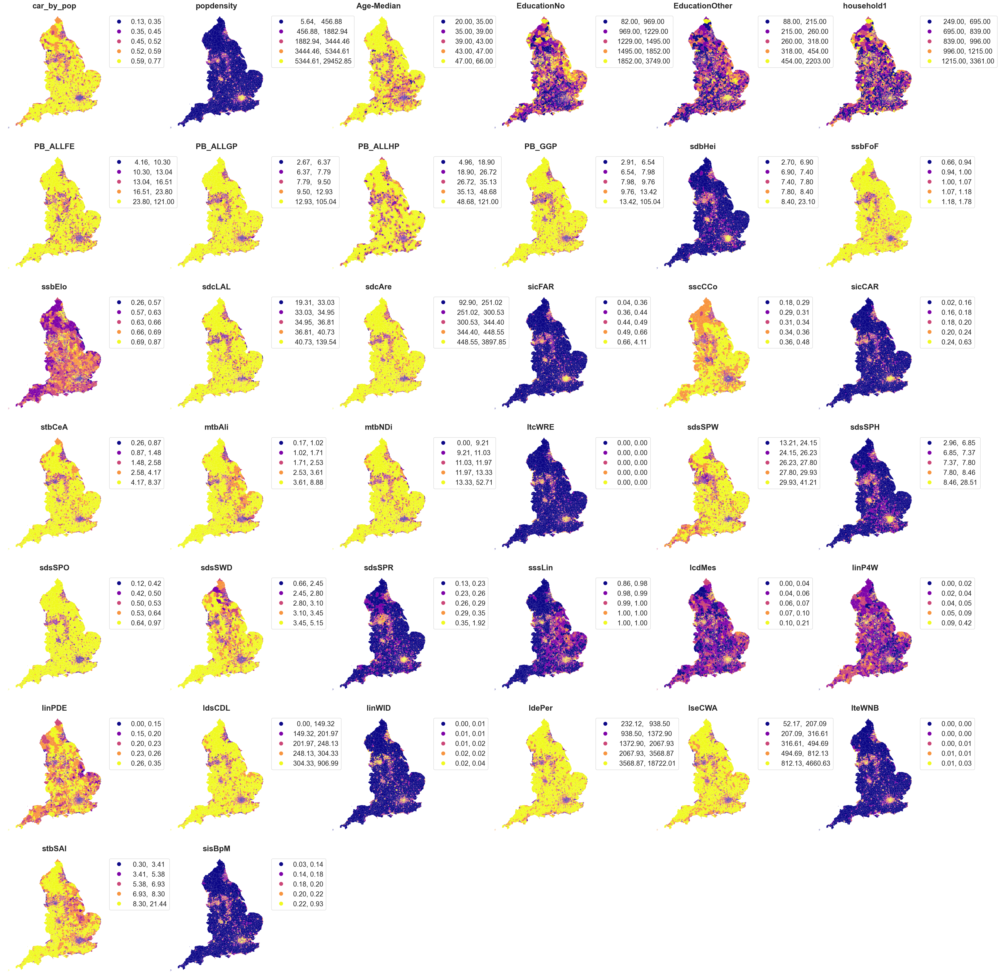

In [ ]:
#same features as esda_selectedfeatures with features that have higher correlation and significant value against car by pop

df_msoa= gpd.GeoDataFrame(df_msoa, geometry='geometry')
p_vars= [
'car_by_pop',
 'popdensity',
 'Age-Median',
 'EducationNo',
 'EducationOther',
'household1',
 'PB_ALLFE',
 'PB_ALLGP',
 'PB_ALLHP',
 'PB_GGP',
 'sdbHei',
 'ssbFoF',
 'ssbElo',
 'sdcLAL',
 'sdcAre',
 'sicFAR',
 'sscCCo',
 'sicCAR',
 'stbCeA',
 'mtbAli',
 'mtbNDi',
 'ltcWRE',
 'sdsSPW',
 'sdsSPH',
 'sdsSPO',
 'sdsSWD',
 'sdsSPR',
 'sssLin',
 'lcdMes',
 'linP4W',
 'linPDE',
 'ldsCDL',
 'linWID',
 'ldePer',
 'lseCWA',
 'lteWNB',
 'stbSAl',
 'sisBpM']
         
         
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec

n_plots = len(p_vars)
# compute the number of rows and columns
n_cols =  int(np.sqrt(n_plots))
n_rows = int(np.ceil(n_plots / n_cols))

# setup the plot
gs = gridspec.GridSpec(n_rows, n_cols)
scale = max(n_cols, n_rows)
fig = plt.figure(figsize=(5 * scale, 5 * scale))

# loop through each subplot and plot values there
for i in range(n_plots):
    ax = fig.add_subplot(gs[i])
    df_msoa.plot(column = p_vars[i],ax=ax,legend=True,legend_kwds={'loc': 'center left', 'bbox_to_anchor':(1,0.5,0.5, 0.5),'fmt':"{:.2f}",'fontsize':'x-large'}, scheme='quantiles', cmap='plasma', linewidth=0.01,)
    ax.set_title(p_vars[i], fontdict={'fontsize': 20, 'fontweight': 'bold'})
    ax.axis('off')
gs.tight_layout(fig, rect=[0, 0, 1.0, 1.0])



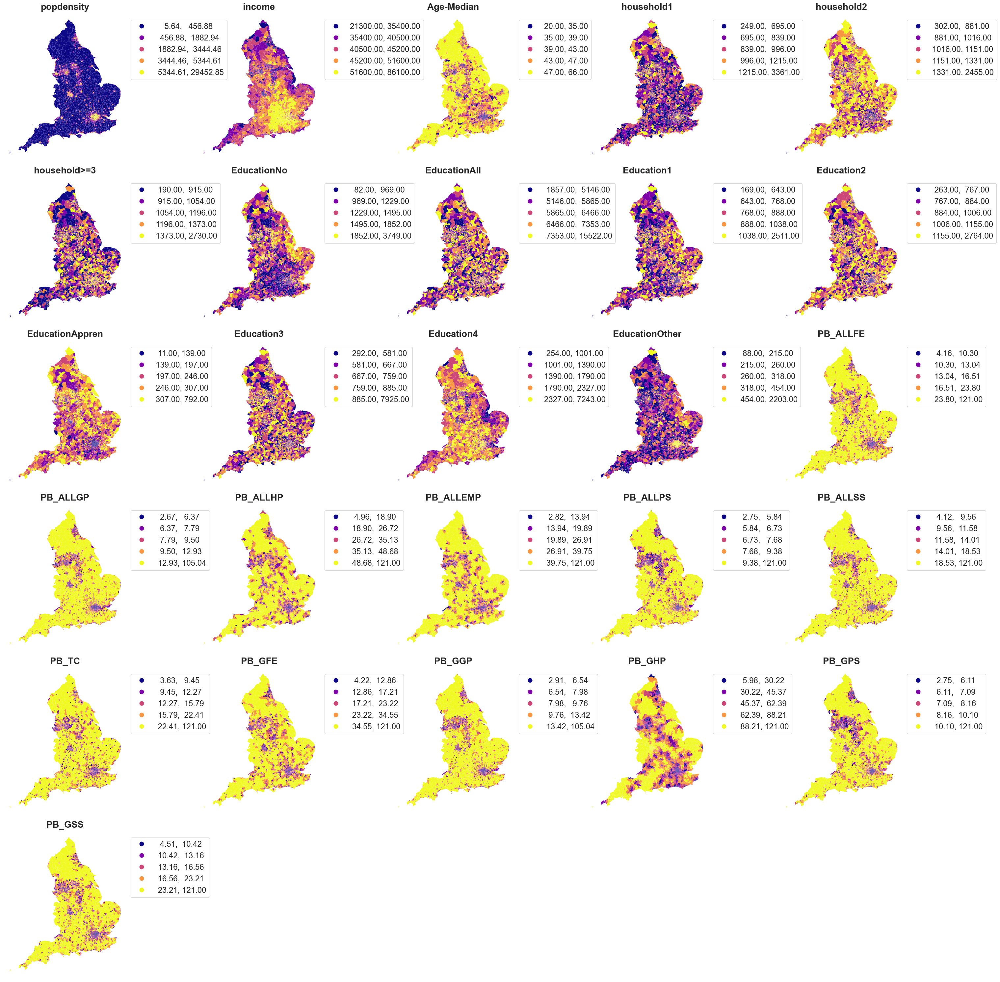

In [ ]:
#all original features

df_msoa= gpd.GeoDataFrame(df_msoa, geometry='geometry')
p_vars= [
'popdensity',
'income',
'Age-Median',
 'household1',
 'household2',
 'household>=3',
 'EducationNo',
 'EducationAll',
 'Education1',
 'Education2',
 'EducationAppren',
 'Education3',
 'Education4',
 'EducationOther',
'PB_ALLFE',
 'PB_ALLGP',
 'PB_ALLHP',
 'PB_ALLEMP',
 'PB_ALLPS',
 'PB_ALLSS',
 'PB_TC',
 'PB_GFE',
 'PB_GGP',
 'PB_GHP',
 'PB_GPS',
 'PB_GSS']
         
         
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec

n_plots = len(p_vars)
# compute the number of rows and columns
n_cols =  int(np.sqrt(n_plots))
n_rows = int(np.ceil(n_plots / n_cols))

# setup the plot
gs = gridspec.GridSpec(n_rows, n_cols)
scale = max(n_cols, n_rows)
fig = plt.figure(figsize=(5 * scale, 5 * scale))

# loop through each subplot and plot values there
for i in range(n_plots):
    ax = fig.add_subplot(gs[i])
    df_msoa.plot(column = p_vars[i],ax=ax,legend=True,legend_kwds={'loc': 'center left', 'bbox_to_anchor':(1,0.5,0.5, 0.5),'fmt':"{:.2f}",'fontsize':'x-large'}, scheme='quantiles', cmap='plasma', linewidth=0.01,)
    ax.set_title(p_vars[i], fontdict={'fontsize': 20, 'fontweight': 'bold'})
    ax.axis('off')
gs.tight_layout(fig, rect=[0, 0, 1.0, 1.0])

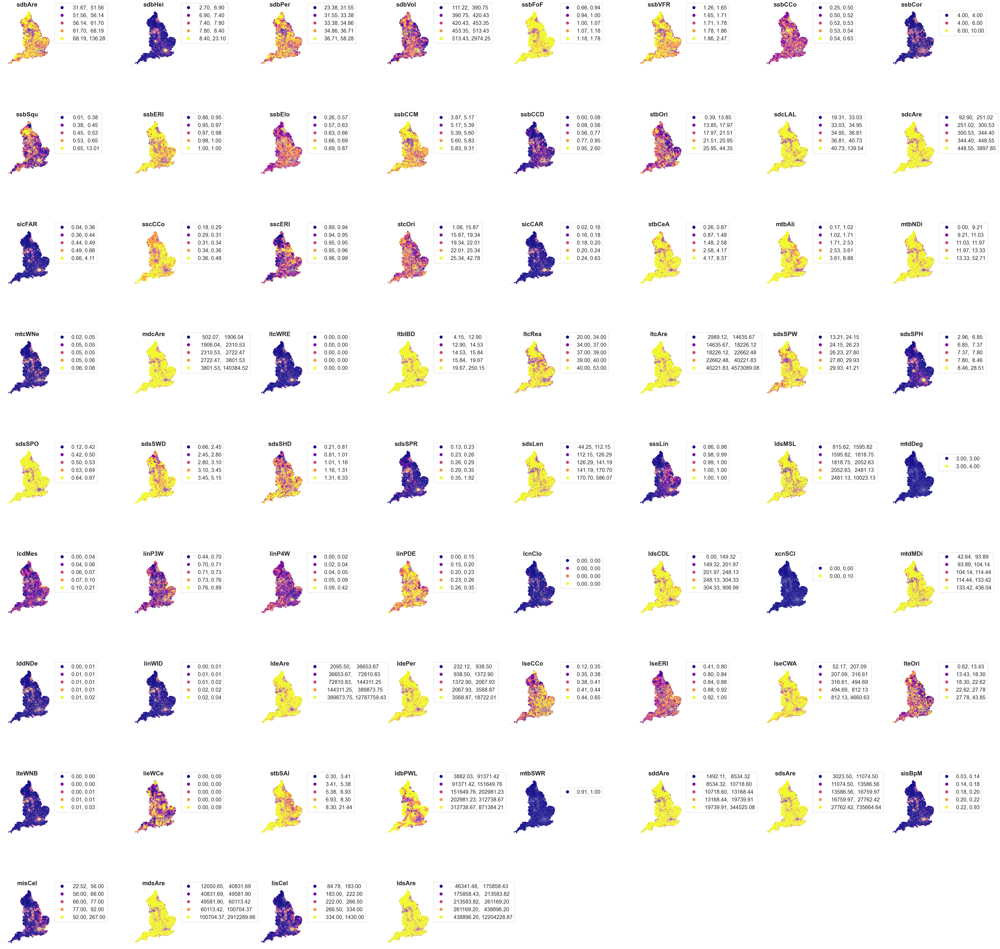

In [ ]:
#all original features

df_msoa= gpd.GeoDataFrame(df_msoa, geometry='geometry')
p_vars= [
'sdbAre',
 'sdbHei',
 'sdbPer',
 'sdbVol',
 'ssbFoF',
 'ssbVFR',
 'ssbCCo',
 'ssbCor',
 'ssbSqu',
 'ssbERI',
 'ssbElo',
 'ssbCCM',
 'ssbCCD',
 'stbOri',
 'sdcLAL',
 'sdcAre',
 'sicFAR',
 'sscCCo',
 'sscERI',
 'stcOri',
 'sicCAR',
 'stbCeA',
 'mtbAli',
 'mtbNDi',
 'mtcWNe',
 'mdcAre',
 'ltcWRE',
 'ltbIBD',
 'ltcRea',
 'ltcAre',
 'sdsSPW',
 'sdsSPH',
 'sdsSPO',
 'sdsSWD',
 'sdsSHD',
 'sdsSPR',
 'sdsLen',
 'sssLin',
 'ldsMSL',
 'mtdDeg',
 'lcdMes',
 'linP3W',
 'linP4W',
 'linPDE',
 'lcnClo',
 'ldsCDL',
 'xcnSCl',
 'mtdMDi',
 'lddNDe',
 'linWID',
 'ldeAre',
 'ldePer',
 'lseCCo',
 'lseERI',
 'lseCWA',
 'lteOri',
 'lteWNB',
 'lieWCe',
 'stbSAl',
 'ldbPWL',
 'mtbSWR',
 'sddAre',
 'sdsAre',
 'sisBpM',
 'misCel',
 'mdsAre',
 'lisCel',
 'ldsAre']
         
         
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec

n_plots = len(p_vars)
# compute the number of rows and columns
n_cols =  int(np.sqrt(n_plots))
n_rows = int(np.ceil(n_plots / n_cols))

# setup the plot
gs = gridspec.GridSpec(n_rows, n_cols)
scale = max(n_cols, n_rows)
fig = plt.figure(figsize=(5 * scale, 5 * scale))

# loop through each subplot and plot values there
for i in range(n_plots):
    ax = fig.add_subplot(gs[i])
    df_msoa.plot(column = p_vars[i],ax=ax,legend=True,legend_kwds={'loc': 'center left', 'bbox_to_anchor':(1,0.5,0.5, 0.5),'fmt':"{:.2f}",'fontsize':'x-large'}, scheme='quantiles', cmap='plasma', linewidth=0.01,)
    ax.set_title(p_vars[i], fontdict={'fontsize': 20, 'fontweight': 'bold'})
    ax.axis('off')
gs.tight_layout(fig, rect=[0, 0, 1.0, 1.0])

## Preparation of Data for Machine Learning

### Split test and train by K-Means Cluster of Spatial Area Close to Each Other

In [ ]:
import geopandas 
df_msoa = geopandas.GeoDataFrame(df_msoa)

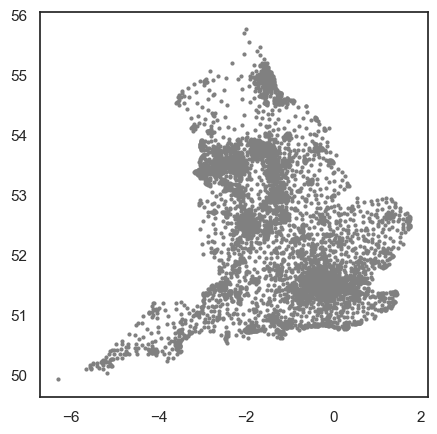

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(5,5))
plt.scatter(x=df_msoa['LONG_'], y=df_msoa['LAT'],marker="o",s=4,c='grey')
plt.show()

In [ ]:
df_msoa.head(1)

,OBJECTID,MSOA11CD,MSOA11NM_x,LONG_,LAT,geometry,cars,Mid-2020 population,Area Sq Km,household,household1,household2,household>=3,EducationAll,EducationNo,Education1,Education2,EducationAppren,Education3,Education4,EducationOther,income,sdbAre,sdbHei,sdbPer,sdbVol,ssbFoF,ssbVFR,ssbCCo,ssbCor,ssbSqu,ssbERI,ssbElo,ssbCCM,ssbCCD,stbOri,sdcLAL,sdcAre,sicFAR,sscCCo,sscERI,stcOri,sicCAR,stbCeA,mtbAli,mtbNDi,mtcWNe,mdcAre,ltcWRE,ltbIBD,ltcRea,ltcAre,sdsSPW,sdsSPH,sdsSPO,sdsSWD,sdsSHD,sdsSPR,sdsLen,sssLin,ldsMSL,mtdDeg,lcdMes,linP3W,linP4W,linPDE,lcnClo,ldsCDL,xcnSCl,mtdMDi,lddNDe,linWID,ldeAre,ldePer,lseCCo,lseERI,lseCWA,lteOri,lteWNB,lieWCe,stbSAl,ldbPWL,mtbSWR,sddAre,sdsAre,sisBpM,misCel,mdsAre,lisCel,ldsAre,MSOA Name,Age-Median,PB_ALLFE,PB_ALLGP,PB_ALLHP,PB_ALLEMP,PB_ALLPS,PB_ALLSS,PB_TC,PB_GFE,PB_GGP,PB_GHP,PB_GPS,PB_GSS,popdensity,car_by_pop,car_by_area
0,1,E02000001,City of London 001,-0.093490,51.515600,"POLYGON ((-0.09650 51.52295, -0.09644 51.52282...","2,471.000000","10,938.000000",2.897800,4385,2472,1356,557,6755,454,291,445,47,484,4618,416,65400,136.281525,23.100000,58.283511,"2,974.246398",0.700039,2.390425,0.449578,6.000000,7.674560,0.960637,0.556337,9.308943,1.393034,14.440616,33.546958,329.880524,4.108696,0.440538,0.948504,14.976634,0.546623,1.169718,3.687775,4.295645,0.047514,"5,843.074404",0.000148,7.959321,48.000000,"55,282.392037",16.753407,28.510000,0.342105,2.241302,6.327217,1.920859,94.505906,0.998659,"1,745.845214",3.000000,0.116392,0.793103,0.096464,0.103448,0.000003,64.850920,0.000000,78.751731,0.011595,0.021847,"21,387.060200",651.194361,0.456875,0.880349,129.770081,13.761036,0.011546,0.001467,5.158044,"38,022.082707",1.000000,"5,743.826905","12,002.070705",0.113414,29.000000,"49,620.352109",111.122772,"227,273.375613",City of London 001,35,10.276263,6.606503,8.925261,4.455071,6.469298,10.530612,16.289416,10.915395,6.606503,9.840775,6.469298,10.919092,"3,774.590000",0.230000,852.720000


In [ ]:
# Create dataframe with the Longitude and Latitude to use K-Means to create a cluster
clust=df_msoa.loc[:,['MSOA11CD','LONG_','LAT']]
clust.head(1)

,MSOA11CD,LONG_,LAT
0,E02000001,-0.093490,51.515600


#### K-Means to Group create 4 Clusters by Spatial Area for K-Fold Cross Validation for Linear Regression and RainForest

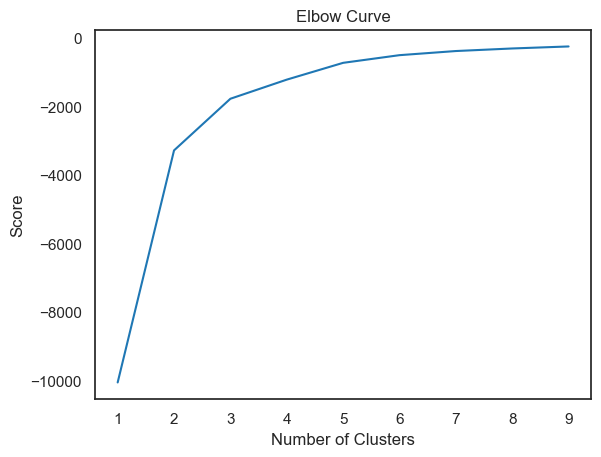

In [ ]:
K_clusters = range(1,10)
kmeans = [KMeans(n_clusters=i) for i in K_clusters]
Y_axis = clust[['LONG_']]
X_axis = clust[['LAT']]
score = [kmeans[i].fit(Y_axis).score(Y_axis) for i in range(len(kmeans))]
# Visualize
plt.plot(K_clusters, score)
plt.xlabel('Number of Clusters')
plt.ylabel('Score')
plt.title('Elbow Curve')
plt.show()

In [ ]:
kmeans = KMeans(n_clusters = 4, init ='k-means++',random_state=1)
kmeans.fit(clust[clust.columns[1:3]]) # Compute k-means clustering.
clust['cluster_label'] = kmeans.fit_predict(clust[clust.columns[1:3]])
centers = kmeans.cluster_centers_ # Coordinates of cluster centers.
labels = kmeans.predict(clust[clust.columns[1:3]]) # Labels of each point
clust.head(2)

,MSOA11CD,LONG_,LAT,cluster_label
0,E02000001,-0.093490,51.515600,1
1,E02000002,0.138756,51.586500,1


How Many MSOA in Each Cluster
cluster_label
0    1597
1    2718
2    1713
3     763
dtype: int64


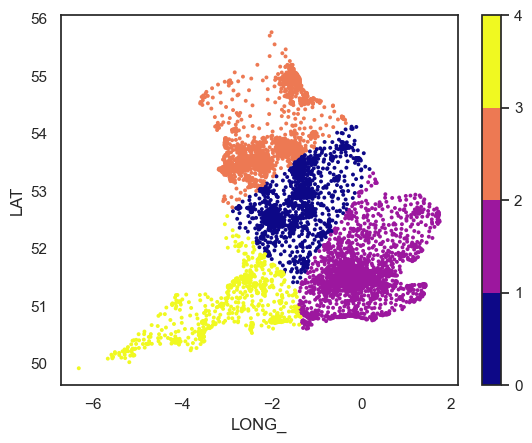

<Figure size 500x500 with 0 Axes>

In [ ]:
from matplotlib import pyplot as plt
import numpy as np
from matplotlib import colors
cmap = plt.cm.plasma
norm = colors.BoundaryNorm(np.arange(0, 5, 1), cmap.N)
clust.plot.scatter(x = 'LONG_', y = 'LAT', c=labels, cmap=cmap, norm=norm, edgecolor='none',s=8)
plt.figure(figsize=(5,5))
print('How Many MSOA in Each Cluster')
print(clust.groupby('cluster_label').size()) #find how many MSOA in each cluster

In [ ]:
clust = clust.sort_values(by=['cluster_label']).reset_index(drop=True) #Sort by Cluster

In [ ]:
clust.head(1)

,MSOA11CD,LONG_,LAT,cluster_label
0,E02003212,-1.700090,51.633400,0


In [ ]:
df = clust.merge(df_msoa, left_on='MSOA11CD', right_on='MSOA11CD') #Merge with Original Dataframe to add Cluster label

In [ ]:
df = df.drop(['car_by_area','Area Sq Km'],axis=1) #drop unrelated factors to the study

## Create Three Data Frames for Machine Learning
### 1st Model with Car By Pop, Explanatory Variables: Original Features Discussed in Literature df1
### 2nd Model with Car By Pop, Urban Form Features Only df3
### 3rd Model with Car By Pop, All Features Including Urban Features df2

In [ ]:
df1 = pd.DataFrame(df[['MSOA11CD',
           'car_by_pop',
 'cluster_label',
 'Age-Median',
 'popdensity',
 'household',
 'household1',
 'household2',
 'household>=3',
 'EducationAll',
 'EducationNo',
 'Education1',
 'Education2',
 'EducationAppren',
 'Education3',
 'Education4',
 'EducationOther',
 'income',
'PB_ALLFE',
 'PB_ALLGP',
 'PB_ALLHP',
 'PB_ALLEMP',
 'PB_ALLPS',
 'PB_ALLSS',
 'PB_TC',
 'PB_GFE',
 'PB_GGP',
 'PB_GHP',
 'PB_GPS',
 'PB_GSS']])

#Data Frame 2 All Features
df2 = pd.DataFrame(df[['MSOA11CD',
           'car_by_pop',
 'cluster_label',
 'Age-Median',
 'popdensity',
 'household',
 'household1',
 'household2',
 'household>=3',
 'EducationAll',
 'EducationNo',
 'Education1',
 'Education2',
 'EducationAppren',
 'Education3',
 'Education4',
 'EducationOther',
 'income',
'PB_ALLFE',
 'PB_ALLGP',
 'PB_ALLHP',
 'PB_ALLEMP',
 'PB_ALLPS',
 'PB_ALLSS',
 'PB_TC',
 'PB_GFE',
 'PB_GGP',
 'PB_GHP',
 'PB_GPS',
 'PB_GSS',
'sdbAre',
 'sdbHei',
 'sdbPer',
 'sdbVol',
 'ssbFoF',
 'ssbVFR',
 'ssbCCo',
 'ssbCor',
 'ssbSqu',
 'ssbERI',
 'ssbElo',
 'ssbCCM',
 'ssbCCD',
 'stbOri',
 'sdcLAL',
 'sdcAre',
 'sicFAR',
 'sscCCo',
 'sscERI',
 'stcOri',
 'sicCAR',
 'stbCeA',
 'mtbAli',
 'mtbNDi',
 'mtcWNe',
 'mdcAre',
 'ltcWRE',
 'ltbIBD',
 'ltcRea',
 'ltcAre',
 'sdsSPW',
 'sdsSPH',
 'sdsSPO',
 'sdsSWD',
 'sdsSHD',
 'sdsSPR',
 'sdsLen',
 'sssLin',
 'ldsMSL',
 'mtdDeg',
 'lcdMes',
 'linP3W',
 'linP4W',
 'linPDE',
 'lcnClo',
 'ldsCDL',
 'xcnSCl',
 'mtdMDi',
 'lddNDe',
 'linWID',
 'ldeAre',
 'ldePer',
 'lseCCo',
 'lseERI',
 'lseCWA',
 'lteOri',
 'lteWNB',
 'lieWCe',
 'stbSAl',
 'ldbPWL',
 'mtbSWR',
 'sddAre',
 'sdsAre',
 'sisBpM',
 'misCel',
 'mdsAre',
 'lisCel',
 'ldsAre']])

#Data Frame 3 Only Urban Features

df3 = pd.DataFrame(df[['MSOA11CD',
           'car_by_pop',
 'cluster_label',
          'sdbAre',
 'sdbHei',
 'sdbPer',
 'sdbVol',
 'ssbFoF',
 'ssbVFR',
 'ssbCCo',
 'ssbCor',
 'ssbSqu',
 'ssbERI',
 'ssbElo',
 'ssbCCM',
 'ssbCCD',
 'stbOri',
 'sdcLAL',
 'sdcAre',
 'sicFAR',
 'sscCCo',
 'sscERI',
 'stcOri',
 'sicCAR',
 'stbCeA',
 'mtbAli',
 'mtbNDi',
 'mtcWNe',
 'mdcAre',
 'ltcWRE',
 'ltbIBD',
 'ltcRea',
 'ltcAre',
 'sdsSPW',
 'sdsSPH',
 'sdsSPO',
 'sdsSWD',
 'sdsSHD',
 'sdsSPR',
 'sdsLen',
 'sssLin',
 'ldsMSL',
 'mtdDeg',
 'lcdMes',
 'linP3W',
 'linP4W',
 'linPDE',
 'lcnClo',
 'ldsCDL',
 'xcnSCl',
 'mtdMDi',
 'lddNDe',
 'linWID',
 'ldeAre',
 'ldePer',
 'lseCCo',
 'lseERI',
 'lseCWA',
 'lteOri',
 'lteWNB',
 'lieWCe',
 'stbSAl',
 'ldbPWL',
 'mtbSWR',
 'sddAre',
 'sdsAre',
 'sisBpM',
 'misCel',
 'mdsAre',
 'lisCel',
 'ldsAre']])

In [ ]:
type(df3)

pandas.core.frame.DataFrame

# Results: Machine Learning Models

## Lasso Regression

#### Lasso Regression for Original Features 

In [ ]:
i = [0,1,2,3]
results_train = list()
results_test = list()
for i in df1['cluster_label'].unique():
    test = df1[df1['cluster_label'] == i]
    X_test = test.drop(['MSOA11CD','car_by_pop','cluster_label'],axis=1)
    features = X_test.columns
    y_test = test['car_by_pop']
    train= df1[df1['cluster_label'] != i]
    X_train = train.drop(['MSOA11CD','car_by_pop','cluster_label'],axis=1)
    y_train = train['car_by_pop']
    y_train= y_train.values.reshape(-1,1)
    y_test= y_test.values.reshape(-1,1)
    sc_X = StandardScaler()
    sc_y = StandardScaler()
    X_train = sc_X.fit_transform(X_train)
    X_test = sc_X.fit_transform(X_test)
    y_train = sc_X.fit_transform(y_train)
    y_test = sc_y.fit_transform(y_test)
    lasso_model1 = Lasso(alpha = 0.001)
    lasso_model1.fit(X_train,y_train)
    train_score=lasso_model1.score(X_train,y_train)
    test_score=lasso_model1.score(X_test,y_test)
    coeff_used = np.sum(lasso_model1.coef_!=0)
    print('only Original Factors')
    print('')
    print('training score Fold',i+1,':',train_score)
    print('test score Fold',i+1,':', test_score)
    print('number of features Fold',i+1,':', coeff_used)
    results_train.append(train_score)
    results_test.append(test_score)
print('')
print("training score mean:", np.mean(results_train))
print("testing score mean:", np.mean(results_test))
lasso_orig_acc_train = results_train
lasso_orig_acc_test = results_test

lasso_mean_orig_train = np.mean(results_train) #final train score for all folds
lasso_mean_orig_test = np.mean(results_test) #final test score for all folds

only Original Factors

training score Fold 1 : 0.859520922288507
test score Fold 1 : 0.8189522052242113
number of features Fold 1 : 25
only Original Factors

training score Fold 2 : 0.8558156523814595
test score Fold 2 : 0.7675625058705998
number of features Fold 2 : 23
only Original Factors

training score Fold 3 : 0.8626095329993035
test score Fold 3 : 0.8078298314155758
number of features Fold 3 : 22
only Original Factors

training score Fold 4 : 0.8545491369828699
test score Fold 4 : 0.8116393144383313
number of features Fold 4 : 24

training score mean: 0.8581238111630349
testing score mean: 0.8014959642371796


#### Lasso Regression for Urban Form Features

In [ ]:
from sklearn import metrics
i = [0,1,2,3]
results_train = list()
results_test = list()
results_mse = list()
results_mae = list()
y_pred_list = list()
y_test_list = list()
results_r2_list = list()

for i in df3['cluster_label'].unique():
    test = df3[df3['cluster_label'] == i]
   
    X_test = test.drop(['MSOA11CD','car_by_pop','cluster_label'],axis=1)
    features = X_test.columns
    y_test = test['car_by_pop']
    train= df3[df3['cluster_label'] != i]
    X_train = train.drop(['MSOA11CD','car_by_pop','cluster_label'],axis=1)
    y_train = train['car_by_pop']
    y_train= y_train.values.reshape(-1,1)
    y_test= y_test.values.reshape(-1,1)
    sc_X = StandardScaler()
    sc_y = StandardScaler()
    X_train = sc_X.fit_transform(X_train)
    X_test = sc_X.fit_transform(X_test)
    y_train = sc_X.fit_transform(y_train)
    y_test = sc_y.fit_transform(y_test)
    lasso_all = Lasso(alpha = 0.01)
    lasso_all.fit(X_train,y_train)
    train_score=lasso_all.score(X_train,y_train)
    test_score=lasso_all.score(X_test,y_test)
    coeff_used = np.sum(lasso_all.coef_!=0)
    y_pred = lasso_all.predict(X_test)
    mse_score = metrics.mean_squared_error(y_test, y_pred)
    mae_score = metrics.mean_absolute_error(y_test, y_pred)
    r2score = metrics.r2_score(y_test, y_pred)
    globals()["p" + str(i)] = lasso_all.coef_
    print('Only Urban Form Features')
    print('')
    print('training score Fold',i+1,':',train_score)
    print('test score Fold',i+1,':', test_score)
    print('number of features Fold',i+1,':', coeff_used)
    print('MSE score',i+1,':',mse_score)
    print('MAE score',i+1,':',mae_score)
    print('r2 score',i+1,':', r2score)

    
    results_train.append(train_score)
    results_test.append(test_score)
    results_mse.append(mse_score)
    results_mae.append(mae_score)
    results_r2_list.append(r2score)
    y_pred_list.append(y_pred)
    y_test_list.append(y_test)
    
    y_test_list.append(y_test)
print('')
print("training score mean:", np.mean(results_train))
print("testing score mean:", np.mean(results_test))
print("MSE All Fold:", np.mean(results_mse))
print("MAE All Fold:", np.mean(results_mae))

lasso_urb_train = results_train
lasso_urb_test = results_test


lasso_mean_urb_train = np.mean(results_train) #final train score for all folds
lasso_mean_urb_test = np.mean(results_test) #final test score for all folds

Only Urban Form Features

training score Fold 1 : 0.7916139804028521
test score Fold 1 : 0.7138282458368772
number of features Fold 1 : 25
MSE score 1 : 0.2861717541631229
MAE score 1 : 0.38594970311334154
r2 score 1 : 0.7138282458368772
Only Urban Form Features

training score Fold 2 : 0.7425898063625805
test score Fold 2 : 0.7800256150722832
number of features Fold 2 : 26
MSE score 2 : 0.2199743849277168
MAE score 2 : 0.35085012089086565
r2 score 2 : 0.7800256150722832
Only Urban Form Features

training score Fold 3 : 0.8004003384465515
test score Fold 3 : 0.6778032679620605
number of features Fold 3 : 24
MSE score 3 : 0.32219673203793947
MAE score 3 : 0.41942890863873206
r2 score 3 : 0.6778032679620605
Only Urban Form Features

training score Fold 4 : 0.7828236355225839
test score Fold 4 : 0.7061185730946361
number of features Fold 4 : 26
MSE score 4 : 0.2938814269053639
MAE score 4 : 0.3932352329672884
r2 score 4 : 0.7061185730946361

training score mean: 0.779356940183642
testing 

#### Lasso Regression for All Features and Feature Importance Analysis 

In [ ]:
from sklearn import metrics
i = [0,1,2,3] #cluster number list for kfold to take as test data set 
results_train = list()
results_test = list()
results_mse = list()
results_mae = list()
results_r2_list = list()

msoa11cd_list = list()
cluster_nolist= list()
y_pred_list = list()
y_test_list = list()
coef_list = list()
for i in df2['cluster_label'].unique(): #run all folds until all cluster label becomes test data k times
    print('test cluster:',i)
    test = df2[df2['cluster_label'] == i] #separate test data
    cluster_no = test['cluster_label'].tolist()
    msoa11cd = test['MSOA11CD'].tolist()
    X_test = test.drop(['MSOA11CD','car_by_pop','cluster_label'],axis=1)#drop unnecessary columns
    features = X_test.columns #save feature names
    y_test = test['car_by_pop']
    train= df2[df2['cluster_label'] != i] #rain always removes test data k-1
    X_train = train.drop(['MSOA11CD','car_by_pop','cluster_label'],axis=1)
    y_train = train['car_by_pop']
    y_train= y_train.values.reshape(-1,1)
    y_test= y_test.values.reshape(-1,1)
    sc_X = StandardScaler()
    sc_y = StandardScaler()
    X_train = sc_X.fit_transform(X_train)
    X_test = sc_X.fit_transform(X_test)
    y_train = sc_X.fit_transform(y_train)
    y_test = sc_y.fit_transform(y_test)
    lasso_all = Lasso(alpha = 0.01)
    lasso_all.fit(X_train,y_train)
    train_score=lasso_all.score(X_train,y_train)
    test_score=lasso_all.score(X_test,y_test)
    coeff_used = np.sum(lasso_all.coef_!=0)
    y_pred = lasso_all.predict(X_test)
    
    mse_score = metrics.mean_squared_error(y_test, y_pred)
    mae_score = metrics.mean_absolute_error(y_test, y_pred)
    r2score = metrics.r2_score(y_test, y_pred)
    globals()["p" + str(i)] = lasso_all.coef_
    print('All Factors: Original Baseline Variables and Urban Form')
    print('')
    print('training score Fold',i+1,':',train_score)
    print('test score Fold',i+1,':', test_score)
    print('number of features Fold',i+1,':', coeff_used)
    print('MSE score',i+1,':',mse_score)
    print('MAE score',i+1,':',mae_score)
    print('r2 score',i+1,':', r2score)
    results_train.append(train_score)
    results_test.append(test_score)
    results_mse.append(mse_score)
    results_mae.append(mae_score)
    coef_list.append(lasso_all.coef_)
    msoa11cd_list.extend(msoa11cd) #save msoa together with its identifier cluster no. 
    cluster_nolist.extend(cluster_no) #save pred, test data together with its identifier and cluster number
    y_pred_list.extend(y_pred.tolist()) #save pred from every loop, all clusters saved
    y_test_list.extend(y_test.tolist()) #for ease just save test for every loop

print('')
print("training score mean:", np.mean(results_train))
print("testing score mean:", np.mean(results_test))
print("MSE All Fold:", np.mean(results_mse))
print("MAE All Fold:", np.mean(results_mae))
lasso_all_train = results_train
lasso_all_test = results_test


lasso_mean_all_train = np.mean(results_train) #final train score for all folds
lasso_mean_all_test = np.mean(results_test) #final test score for all folds

test cluster: 0
All Factors: Original Baseline Variables and Urban Form

training score Fold 1 : 0.8809304042361873
test score Fold 1 : 0.8104050702616453
number of features Fold 1 : 28
MSE score 1 : 0.1895949297383547
MAE score 1 : 0.30991794644778836
r2 score 1 : 0.8104050702616453
test cluster: 1
All Factors: Original Baseline Variables and Urban Form

training score Fold 2 : 0.8625745167950488
test score Fold 2 : 0.7920031812854147
number of features Fold 2 : 30
MSE score 2 : 0.20799681871458534
MAE score 2 : 0.3481978162774864
r2 score 2 : 0.7920031812854147
test cluster: 2
All Factors: Original Baseline Variables and Urban Form

training score Fold 3 : 0.8792309079793021
test score Fold 3 : 0.8238728248003409
number of features Fold 3 : 32
MSE score 3 : 0.17612717519965918
MAE score 3 : 0.29816163302994503
r2 score 3 : 0.8238728248003409
test cluster: 3
All Factors: Original Baseline Variables and Urban Form

training score Fold 4 : 0.8711082954879269
test score Fold 4 : 0.831655

In [ ]:
#combine list of all ypredicted and ytest by MSOA from Lasso test with all features for ESDA
import numpy as np
result_lasso = pd.DataFrame(np.column_stack([msoa11cd_list, cluster_nolist, y_pred_list,y_test_list]), 
                               columns=['MSOA11CD', 'ClusterNo', 'y_pred','y_test'])
result_lasso = result_lasso.astype({'y_pred':'float','y_test':'float'})

df_msoa= gpd.GeoDataFrame(df_msoa, geometry='geometry')
result_lasso = pd.merge(df_msoa[['MSOA11CD','MSOA11NM_x','LONG_','LAT','geometry']],result_lasso,how='left',on='MSOA11CD')

In [ ]:
features = ['Age-Median',
 'popdensity',
 'household',
 'household1',
 'household2',
 'household>=3',
 'EducationAll',
 'EducationNo',
 'Education1',
 'Education2',
 'EducationAppren',
 'Education3',
 'Education4',
 'EducationOther',
 'income',
'PB_ALLFE',
 'PB_ALLGP',
 'PB_ALLHP',
 'PB_ALLEMP',
 'PB_ALLPS',
 'PB_ALLSS',
 'PB_TC',
 'PB_GFE',
 'PB_GGP',
 'PB_GHP',
 'PB_GPS',
 'PB_GSS',
'sdbAre',
 'sdbHei',
 'sdbPer',
 'sdbVol',
 'ssbFoF',
 'ssbVFR',
 'ssbCCo',
 'ssbCor',
 'ssbSqu',
 'ssbERI',
 'ssbElo',
 'ssbCCM',
 'ssbCCD',
 'stbOri',
 'sdcLAL',
 'sdcAre',
 'sicFAR',
 'sscCCo',
 'sscERI',
 'stcOri',
 'sicCAR',
 'stbCeA',
 'mtbAli',
 'mtbNDi',
 'mtcWNe',
 'mdcAre',
 'ltcWRE',
 'ltbIBD',
 'ltcRea',
 'ltcAre',
 'sdsSPW',
 'sdsSPH',
 'sdsSPO',
 'sdsSWD',
 'sdsSHD',
 'sdsSPR',
 'sdsLen',
 'sssLin',
 'ldsMSL',
 'mtdDeg',
 'lcdMes',
 'linP3W',
 'linP4W',
 'linPDE',
 'lcnClo',
 'ldsCDL',
 'xcnSCl',
 'mtdMDi',
 'lddNDe',
 'linWID',
 'ldeAre',
 'ldePer',
 'lseCCo',
 'lseERI',
 'lseCWA',
 'lteOri',
 'lteWNB',
 'lieWCe',
 'stbSAl',
 'ldbPWL',
 'mtbSWR',
 'sddAre',
 'sdsAre',
 'sisBpM',
 'misCel',
 'mdsAre',
 'lisCel',
 'ldsAre']

In [ ]:
#combine feature importance for final model for lasso all features
features = pd.DataFrame(list(features)) #change features name to list 
lasso_coef = pd.DataFrame(list(np.mean(coef_list,axis=0))) #Average coefficients of all alphas in all 4 folds
feature_model = pd.merge(features,lasso_coef,how='left',left_index=True, right_index=True) #join feature  name and coef kfold
feature_model.columns = ['feature','lasso_coef']
feature_model['feature_importance_lasso'] = feature_model['lasso_coef'].abs()
feature_model = feature_model.sort_values('feature_importance_lasso',ascending=False)
feature_model

,feature,lasso_coef,feature_importance_lasso
0,Age-Median,0.247231,0.247231
1,popdensity,-0.205555,0.205555
48,stbCeA,0.165162,0.165162
14,income,0.148846,0.148846
10,EducationAppren,0.093594,0.093594
58,sdsSPH,-0.081126,0.081126
3,household1,-0.077632,0.077632
9,Education2,0.074287,0.074287
7,EducationNo,-0.060462,0.060462
44,sscCCo,0.054797,0.054797


In [ ]:
#combine model 1, model 2, model 3 scores for lasso final score
all_lasso_models_train_score = pd.DataFrame(np.column_stack([lasso_mean_orig_train,lasso_mean_urb_train,lasso_mean_all_train]), 
                               columns=['Lasso Model 1','Lasso Model 2','Lasso Model 3'],index=['Train'])

all_lasso_models_test_score = pd.DataFrame(np.column_stack([lasso_mean_orig_test,lasso_mean_urb_test,lasso_mean_all_test]), 
                               columns=['Lasso Model 1','Lasso Model 2','Lasso Model 3'],index=['test'])

all_lasso_models_train_score.append(all_lasso_models_test_score)

,Lasso Model 1,Lasso Model 2,Lasso Model 3
Train,0.858124,0.779357,0.873461
test,0.801496,0.719444,0.814484


#### Summarize Results for Lasso

In [ ]:
lasso_orig_acc_train,lasso_urb_train,lasso_all_train
lasso_orig_acc_test,lasso_urb_test,lasso_all_test 

#combine list of all ypredicted and ytest by MSOA from Lasso test with all features for ESDA
import numpy as np
model_accuracy_test = pd.DataFrame(np.column_stack([lasso_orig_acc_test,lasso_urb_test,lasso_all_test]), 
                               columns=['lasso_original_test', 'lasso_urban_test', 'lasso_all_test'])
model_accuracy_train = pd.DataFrame(np.column_stack([lasso_orig_acc_train,lasso_urb_train,lasso_all_train]), 
                               columns=['lasso_original_train', 'lasso_urban_train', 'lasso_all_train'])


In [ ]:
lasso_model_results = pd.merge(model_accuracy_train,model_accuracy_test,how='left',left_index=True,right_index=True)

In [ ]:
lasso_model_results
lasso_model_results['Fold'] = lasso_model_results.index+1
lasso_model_results

,lasso_original_train,lasso_urban_train,lasso_all_train,lasso_original_test,lasso_urban_test,lasso_all_test,Fold
0,0.859521,0.791614,0.880930,0.818952,0.713828,0.810405,1
1,0.855816,0.742590,0.862575,0.767563,0.780026,0.792003,2
2,0.862610,0.800400,0.879231,0.807830,0.677803,0.823873,3
3,0.854549,0.782824,0.871108,0.811639,0.706119,0.831656,4


## Rainforest

#### Rainforest Regression for Original Features 

In [ ]:
i = [0,1,2,3]
results_train = list() #list for train score for all folds
results_test = list()  #list for test score for all folds
results_mse = list() #list for mse score for all folds
results_mae = list() #list for mae score for all folds
results_r2_list = list()

for i in df1['cluster_label'].unique():
    test = df1[df1['cluster_label'] == i]
    X_test = test.drop(['MSOA11CD','car_by_pop','cluster_label'],axis=1)
    y_test = test['car_by_pop']
    train= df1[df1['cluster_label'] != i]
    X_train = train.drop(['MSOA11CD','car_by_pop','cluster_label'],axis=1)
    y_train = train['car_by_pop']
    y_train= np.ravel(y_train.values.reshape(-1,1))
    y_test= np.ravel(y_test.values.reshape(-1,1))
    regressor = RandomForestRegressor(n_estimators = 300, random_state = 0)
    regressor.fit(X_train, y_train)
    y_pred = regressor.predict(X_test)
    mse_score = metrics.mean_squared_error(y_test, y_pred)
    mae_score = metrics.mean_absolute_error(y_test, y_pred)
    r2score = metrics.r2_score(y_test, y_pred)
    train_score = regressor.score(X_train, y_train)
    print("R-squared:", score) 
    test_score=regressor.score(X_test,y_test)
    print('Only Original Factors')
    print('')
    print('training score Fold',i+1,':',train_score)
    print('test score Fold',i+1,':', test_score)
    print('MSE score',i+1,':',mse_score)
    print('MAE score',i+1,':',mae_score)
    print('r2 score',i+1,':', r2score)
    print('')
    results_train.append(train_score)
    results_test.append(test_score)
    results_mse.append(mse_score)
    results_mae.append(mae_score)
    results_r2_list.append(r2score)
print('')
print("training score mean:", np.mean(results_train))
print("testing score mean:", np.mean(results_test))
print("MSE All Fold:", np.mean(results_mse))
print("MAE All Fold:", np.mean(results_mae))
rf_orig_train = results_train #save test score of every fold
rf_orig_test = results_test #save test score of every fold

rf_mean_orig_train = np.mean(results_train)
rf_main_orig_test = np.mean(results_test)

rf_mean_orig_train = np.mean(results_train) #final train score for all folds
rf_mean_orig_test = np.mean(results_test) #final test score for all folds

R-squared: [-10046.998594713712, -3277.4545958741082, -1770.9169494639518, -1213.460293139852, -723.3662609111179, -499.641180414421, -379.08424175155403, -304.29038317186496, -245.30813573235562]
Only Original Factors

training score Fold 1 : 0.9847060896171183
test score Fold 1 : 0.8292317135447822
MSE score 1 : 0.002622554647603144
MAE score 1 : 0.0350073262366938
r2 score 1 : 0.8292317135447822

R-squared: [-10046.998594713712, -3277.4545958741082, -1770.9169494639518, -1213.460293139852, -723.3662609111179, -499.641180414421, -379.08424175155403, -304.29038317186496, -245.30813573235562]
Only Original Factors

training score Fold 2 : 0.980557095167241
test score Fold 2 : 0.6762287005685335
MSE score 2 : 0.008313668508707387
MAE score 2 : 0.06793348050036793
r2 score 2 : 0.6762287005685335

R-squared: [-10046.998594713712, -3277.4545958741082, -1770.9169494639518, -1213.460293139852, -723.3662609111179, -499.641180414421, -379.08424175155403, -304.29038317186496, -245.3081357323556

In [ ]:
train['cluster_label'].unique() #double check if k-1 works, last kfold takes out cluster 3 or the 4th cluster
#adds it to test

array([0, 1, 2])

#### Rainforest Regression for Urban features

In [ ]:
i = [0,1,2,3]
results_train = list()
results_test = list()
results_mse = list()
results_mae = list()
results_r2_list = list()

for i in df3['cluster_label'].unique():
    test = df3[df3['cluster_label'] == i]
    X_test = test.drop(['MSOA11CD','car_by_pop','cluster_label'],axis=1)
    y_test = test['car_by_pop']
    train= df3[df3['cluster_label'] != i]
    X_train = train.drop(['MSOA11CD','car_by_pop','cluster_label'],axis=1)
    y_train = train['car_by_pop']
    y_train= np.ravel(y_train.values.reshape(-1,1))
    y_test= np.ravel(y_test.values.reshape(-1,1))
    regressor = RandomForestRegressor(n_estimators = 300, random_state = 0)
    regressor.fit(X_train, y_train)
    y_pred = regressor.predict(X_test)
    mse_score = metrics.mean_squared_error(y_test, y_pred)
    mae_score = metrics.mean_absolute_error(y_test, y_pred)
    r2score = metrics.r2_score(y_test, y_pred)
    train_score = regressor.score(X_train, y_train)
    print("R-squared:", score) 
    test_score=regressor.score(X_test,y_test)
    print('Only urban Factors')
    print('')
    print('training score Fold',i+1,':',train_score)
    print('test score Fold',i+1,':', test_score)
    print('MSE score',i+1,':',mse_score)
    print('MAE score',i+1,':',mae_score)
    print('r2 score',i+1,':', r2score)
    print('')
    results_train.append(train_score)
    results_test.append(test_score)
    results_mse.append(mse_score)
    results_mae.append(mae_score)
    results_r2_list.append(r2score)
print('')
print("training score mean:", np.mean(results_train))
print("testing score mean:", np.mean(results_test))
print("MSE All Fold:", np.mean(results_mse))
print("MAE All Fold:", np.mean(results_mae))
rf_urb_train = results_train
rf_urb_test = results_test
rf_mean_urb_train = np.mean(results_train) #final train score for all folds
rf_mean_urb_test = np.mean(results_test) #final test score for all folds

R-squared: [-10046.998594713712, -3277.4545958741082, -1770.9169494639518, -1213.460293139852, -723.3662609111179, -499.641180414421, -379.08424175155403, -304.29038317186496, -245.30813573235562]
Only urban Factors

training score Fold 1 : 0.9782400311273804
test score Fold 1 : 0.7533226991072941
MSE score 1 : 0.0037883187525220878
MAE score 1 : 0.04350171154247546
r2 score 1 : 0.7533226991072941

R-squared: [-10046.998594713712, -3277.4545958741082, -1770.9169494639518, -1213.460293139852, -723.3662609111179, -499.641180414421, -379.08424175155403, -304.29038317186496, -245.30813573235562]
Only urban Factors

training score Fold 2 : 0.9702845376436546
test score Fold 2 : 0.8101419774000996
MSE score 2 : 0.004875097534543373
MAE score 2 : 0.0523294211429973
r2 score 2 : 0.8101419774000996

R-squared: [-10046.998594713712, -3277.4545958741082, -1770.9169494639518, -1213.460293139852, -723.3662609111179, -499.641180414421, -379.08424175155403, -304.29038317186496, -245.30813573235562]
O

#### Rainforest Regression for All Features

In [ ]:
#rainforest doesn't need standardisation
i = [0,1,2,3]
results_train = list()
results_test = list()
results_mse = list()
results_mae = list()
results_r2_list = list()
featimp_list = list()

msoa11cd_list = list()
cluster_nolist= list()
y_pred_list = list()
y_test_list = list()

for i in df2['cluster_label'].unique():
    print('test cluster:',i)
    test = df2[df2['cluster_label'] == i]
    msoa11cd = test['MSOA11CD'].tolist()
    features = X_test.columns
    cluster_nono = test['cluster_label'].tolist()
    X_test = test.drop(['MSOA11CD','car_by_pop','cluster_label'],axis=1)
    y_test = test['car_by_pop']
    train= df2[df2['cluster_label'] != i]
    X_train = train.drop(['MSOA11CD','car_by_pop','cluster_label'],axis=1)
    y_train = train['car_by_pop']
    y_train= np.ravel(y_train.values.reshape(-1,1))
    y_test= np.ravel(y_test.values.reshape(-1,1))
    regressor = RandomForestRegressor(n_estimators = 300, random_state = 0)
    regressor.fit(X_train, y_train)
    y_pred = regressor.predict(X_test)
    mse_score = metrics.mean_squared_error(y_test, y_pred)
    mae_score = metrics.mean_absolute_error(y_test, y_pred)
    r2score = metrics.r2_score(y_test, y_pred)
    train_score = regressor.score(X_train, y_train)
    print("R-squared:", score) 
    test_score=regressor.score(X_test,y_test)
    print('All factors including Urban Form')
    print('')
    print('training score Fold',i+1,':',train_score)
    print('test score Fold',i+1,':', test_score)
    print('MSE score',i+1,':',mse_score)
    print('MAE score',i+1,':',mae_score)
    print('r2 score',i+1,':', r2score)
    print('')
    results_train.append(train_score)
    results_test.append(test_score)
    results_mse.append(mse_score)
    results_mae.append(mae_score)
    featimp_list.append(regressor.feature_importances_)
    results_r2_list.append(r2score)
    msoa11cd_list.extend(msoa11cd)
    cluster_nolist.extend(cluster_no)
    y_pred_list.extend(y_pred.tolist())
    y_test_list.extend(y_test.tolist())
    
print('')
print("training score mean:", np.mean(results_train))
print("testing score mean:", np.mean(results_test))
print("MSE All Fold:", np.mean(results_mse))
print("MAE All Fold:", np.mean(results_mae))
rf_all_train = results_train
rf_all_test = results_test

rf_mean_all_train = np.mean(results_train)
rf_mean_all_test = np.mean(results_test)

test cluster: 0
R-squared: [-10046.998594713712, -3277.4545958741082, -1770.9169494639518, -1213.460293139852, -723.3662609111179, -499.641180414421, -379.08424175155403, -304.29038317186496, -245.30813573235562]
All factors including Urban Form

training score Fold 1 : 0.9856244500342116
test score Fold 1 : 0.8329912443548089
MSE score 1 : 0.0025648180783413325
MAE score 1 : 0.034379670214986426
r2 score 1 : 0.8329912443548089

test cluster: 1
R-squared: [-10046.998594713712, -3277.4545958741082, -1770.9169494639518, -1213.460293139852, -723.3662609111179, -499.641180414421, -379.08424175155403, -304.29038317186496, -245.30813573235562]
All factors including Urban Form

training score Fold 2 : 0.9811697257695231
test score Fold 2 : 0.7051192210085422
MSE score 2 : 0.007571829406835081
MAE score 2 : 0.06427285994603872
r2 score 2 : 0.7051192210085422

test cluster: 2
R-squared: [-10046.998594713712, -3277.4545958741082, -1770.9169494639518, -1213.460293139852, -723.3662609111179, -499.

In [ ]:
rf_accuracy_train = pd.DataFrame(np.column_stack([rf_orig_train,rf_urb_train,rf_all_train]), 
                               columns=['rf_original_train', 'rf_urban_train', 'rf_all_train'])
rf_accuracy_test = pd.DataFrame(np.column_stack([rf_orig_test,rf_urb_test,rf_all_test]), 
                               columns=['rf_original_test', 'rf_urban_test', 'rf_all_test'])

In [ ]:
rf_model_results = pd.merge(rf_accuracy_train,rf_accuracy_test,how='left',left_index=True,right_index=True)
rf_model_results
mylist = ['KFold 1','KFold 2','KFold 3','KFold 4']
rf_model_results['KFold Cluster'] = np.array(mylist)
rf_model_results

,rf_original_train,rf_urban_train,rf_all_train,rf_original_test,rf_urban_test,rf_all_test,KFold Cluster
0,0.984706,0.978240,0.985624,0.829232,0.753323,0.832991,KFold 1
1,0.980557,0.970285,0.981170,0.676229,0.810142,0.705119,KFold 2
2,0.984409,0.978418,0.984625,0.795313,0.714589,0.816780,KFold 3
3,0.983388,0.976082,0.983822,0.831298,0.764049,0.848034,KFold 4


In [ ]:
rf_pred_list = sc_y.fit_transform(pd.DataFrame(y_pred_list)) #save predicted by rainforest and standard car by pop to make it comparable to lasso 

In [ ]:
features = pd.DataFrame(list(features))
feature_importance_rf = pd.DataFrame(list(np.mean(featimp_list,axis=0))) #feature imp of all folds mean

In [ ]:
rf_feature_imp = pd.merge(features,pd.DataFrame(feature_importance_rf),how='left',left_index=True, right_index=True)
rf_feature_imp.columns = ['feature','rf_feature_importance'] #save feature importance

In [ ]:
rf_feature_imp

,feature,rf_feature_importance
0,Age-Median,0.071895
1,popdensity,0.026750
2,household,0.000854
3,household1,0.002854
4,household2,0.001064
5,household>=3,0.001225
6,EducationAll,0.001003
7,EducationNo,0.002789
8,Education1,0.001265
9,Education2,0.001226


In [ ]:
#combine model 1, model 2, model 3 scores for Random Forest
all_RF_models_train_score = pd.DataFrame(np.column_stack([rf_mean_orig_train,rf_mean_urb_train,rf_mean_all_train]), 
                               columns=['RF Model 1','RF Model 2','RF Model 3'],index=['Train'])

all_RF_models_test_score = pd.DataFrame(np.column_stack([rf_mean_orig_test,rf_mean_urb_test,rf_mean_all_test]), 
                               columns=['RF Model 1','RF Model 2','RF Model 3'],index=['test'])

all_RF_models_train_score.append(all_RF_models_test_score)

,RF Model 1,RF Model 2,RF Model 3
Train,0.983265,0.975756,0.983810
test,0.783018,0.760525,0.800731


## Combined Model Results

In [ ]:
combined_feature = pd.merge(feature_model,rf_feature_imp,how='left',on='feature') #merge feature importance with feature name
combined_feature

,feature,lasso_coef,feature_importance_lasso,rf_feature_importance
0,Age-Median,0.247231,0.247231,0.071895
1,popdensity,-0.205555,0.205555,0.026750
2,stbCeA,0.165162,0.165162,0.585971
3,income,0.148846,0.148846,0.027042
4,EducationAppren,0.093594,0.093594,0.092119
5,sdsSPH,-0.081126,0.081126,0.004828
6,household1,-0.077632,0.077632,0.002854
7,Education2,0.074287,0.074287,0.001226
8,EducationNo,-0.060462,0.060462,0.002789
9,sscCCo,0.054797,0.054797,0.002781


In [ ]:
#add pvalue with car by pop for the above table to show, final feature added and initial p value with coefficient
pvalue_corr['feature']= pvalue_corr[['car_by_pop']].index #from pvalue dataframe create feature column
pvalue_corr = pvalue_corr.rename({'car_by_pop':'pvalue'},axis=1) #rename car by pop pvalue to pvalue for the new table
final_feature = pd.merge(combined_feature,pvalue_corr[['feature','pvalue']],how='left',on='feature') #create final feature analysis table
final_feature #combine with lasso results

,feature,lasso_coef,feature_importance_lasso,rf_feature_importance,pvalue
0,Age-Median,0.247231,0.247231,0.071895,0.000000
1,popdensity,-0.205555,0.205555,0.026750,0.000000
2,stbCeA,0.165162,0.165162,0.585971,0.000000
3,income,0.148846,0.148846,0.027042,0.000000
4,EducationAppren,0.093594,0.093594,0.092119,0.000000
5,sdsSPH,-0.081126,0.081126,0.004828,0.000000
6,household1,-0.077632,0.077632,0.002854,0.000000
7,Education2,0.074287,0.074287,0.001226,0.000000
8,EducationNo,-0.060462,0.060462,0.002789,0.000000
9,sscCCo,0.054797,0.054797,0.002781,0.000000


In [ ]:
#assign asterisk instead of pvalue to show the strenght of significance in academic/scientific language
def assign_asterisk(row):
    if row >= 0.05:
        result = 'ns'
    elif row <= 0.0001:
        result = '****'
    elif row <= 0.001:
        result = '***'
    elif row <=0.01:
        result = '**'
    elif row <=0.05:
        result = '*'
    else:
        pass
    return result
final_feature['pval'] = final_feature['pvalue'].apply(assign_asterisk)

In [ ]:
final_feature.head(1)

,feature,lasso_coef,feature_importance_lasso,rf_feature_importance,pvalue,pval
0,Age-Median,0.247231,0.247231,0.071895,0.000000,****


In [ ]:
final_feature = final_feature.fillna(0) #fill na for any feature not related to lasso and nan
final_feature = final_feature[['feature','lasso_coef','feature_importance_lasso','rf_feature_importance','pval']]
final_feature = final_feature.iloc[:30,:]

In [ ]:
final_feature

,feature,lasso_coef,feature_importance_lasso,rf_feature_importance,pval
0,Age-Median,0.247231,0.247231,0.071895,****
1,popdensity,-0.205555,0.205555,0.026750,****
2,stbCeA,0.165162,0.165162,0.585971,****
3,income,0.148846,0.148846,0.027042,****
4,EducationAppren,0.093594,0.093594,0.092119,****
5,sdsSPH,-0.081126,0.081126,0.004828,****
6,household1,-0.077632,0.077632,0.002854,****
7,Education2,0.074287,0.074287,0.001226,****
8,EducationNo,-0.060462,0.060462,0.002789,****
9,sscCCo,0.054797,0.054797,0.002781,****


In [ ]:
#style final feature and pvalue table for feature results with html style bar
final_feature = final_feature.rename({'feature_importance_lasso':'lasso_feature_importance'},axis=1)
final_feature.style.bar(subset=['lasso_coef','lasso_feature_importance','rf_feature_importance'],align='mid', color=['#d65f5f', '#5fba7d']).hide_index().set_properties(**{'border-left': '1px solid light grey','background-color':'white'})

feature,lasso_coef,lasso_feature_importance,rf_feature_importance,pval
Age-Median,0.247231,0.247231,0.071895,****
popdensity,-0.205555,0.205555,0.026750,****
stbCeA,0.165162,0.165162,0.585971,****
income,0.148846,0.148846,0.027042,****
EducationAppren,0.093594,0.093594,0.092119,****
sdsSPH,-0.081126,0.081126,0.004828,****
household1,-0.077632,0.077632,0.002854,****
Education2,0.074287,0.074287,0.001226,****
EducationNo,-0.060462,0.060462,0.002789,****
sscCCo,0.054797,0.054797,0.002781,****


In [ ]:
top_features = final_feature['feature'].tolist()

In [ ]:
from numpy import asarray
from sklearn.preprocessing import MinMaxScaler
top_features_corr= df2[top_features]
scaler = MinMaxScaler()
# transform data
top_features_corr = scaler.fit_transform(top_features_corr)

In [ ]:
top_features_corr = pd.DataFrame(top_features_corr,columns = top_features)

<AxesSubplot: >

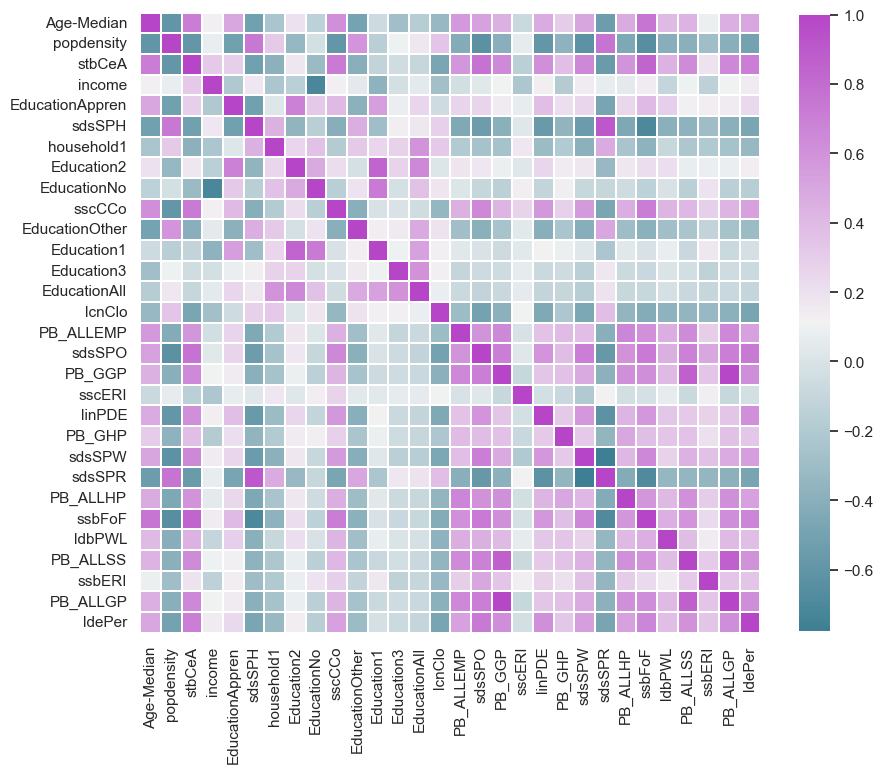

In [ ]:
corr = top_features_corr.corr()
#study correlation of features only isolating and coloring features with negative or positive correlation exceed 0.65 absolute value
plt.figure(figsize=(10,10))
corr = top_features_corr.corr()
cmap=sns.diverging_palette(220, 300, s=75, l=50, sep=1, n=6, as_cmap=True,center='light')
#cmap = sns.diverging_palette(145, 300, s=60, as_cmap=True)
#cmap = sns.diverging_palette(500,350, s=75, l=50, sep=1, n=6, center='light', as_cmap=True)
sns.heatmap(corr,cmap=cmap,cbar=True,square=True,linewidths=0.05, cbar_kws={"shrink": 0.8})

## Compile Results of For RF Predicted

In [ ]:
import numpy as np
result_rf = pd.DataFrame(np.column_stack([msoa11cd_list, rf_pred_list]), 
                               columns=['MSOA11CD', 'rf_pred'])
result_rf = result_rf.astype({'rf_pred':'float'})

In [ ]:
model_results = pd.merge(result_lasso,result_rf[['MSOA11CD','rf_pred']],how='left',on='MSOA11CD')

In [ ]:
model_results = model_results.rename({'y_pred':'lasso_pred','y_test':'actual'},axis=1)

In [ ]:
model_results.head()

,MSOA11CD,MSOA11NM_x,LONG_,LAT,geometry,ClusterNo,lasso_pred,actual,rf_pred
0,E02000001,City of London 001,-0.093490,51.515600,"POLYGON ((-0.09650 51.52295, -0.09644 51.52282...",1,-1.372061,-1.376296,-0.831893
1,E02000002,Barking and Dagenham 001,0.138756,51.586500,"POLYGON ((0.14810 51.59656, 0.14809 51.59640, ...",1,-0.809608,-0.752241,-1.144560
2,E02000003,Barking and Dagenham 002,0.138149,51.576000,"POLYGON ((0.14847 51.58083, 0.14841 51.58075, ...",1,-0.500162,-0.689836,-0.796376
3,E02000004,Barking and Dagenham 003,0.176828,51.556400,"POLYGON ((0.18511 51.56480, 0.18479 51.56455, ...",1,-0.346033,-0.377808,-0.374123
4,E02000005,Barking and Dagenham 004,0.144267,51.560700,"POLYGON ((0.15187 51.56778, 0.15193 51.56775, ...",1,-0.762161,-0.814647,-1.165810


## Compile Results of All Folds and Accuracy for Mean/Train Test, MSE and MAE

In [ ]:
rf_model_results

,rf_original_train,rf_urban_train,rf_all_train,rf_original_test,rf_urban_test,rf_all_test,KFold Cluster
0,0.984706,0.978240,0.985624,0.829232,0.753323,0.832991,KFold 1
1,0.980557,0.970285,0.981170,0.676229,0.810142,0.705119,KFold 2
2,0.984409,0.978418,0.984625,0.795313,0.714589,0.816780,KFold 3
3,0.983388,0.976082,0.983822,0.831298,0.764049,0.848034,KFold 4


In [ ]:
lasso_model_results

,lasso_original_train,lasso_urban_train,lasso_all_train,lasso_original_test,lasso_urban_test,lasso_all_test,Fold
0,0.859521,0.791614,0.880930,0.818952,0.713828,0.810405,1
1,0.855816,0.742590,0.862575,0.767563,0.780026,0.792003,2
2,0.862610,0.800400,0.879231,0.807830,0.677803,0.823873,3
3,0.854549,0.782824,0.871108,0.811639,0.706119,0.831656,4


In [ ]:
model_accuracy = pd.merge(lasso_model_results,rf_model_results,how='left',left_index=True,right_index=True)
model_accuracy

,lasso_original_train,lasso_urban_train,lasso_all_train,lasso_original_test,lasso_urban_test,lasso_all_test,Fold,rf_original_train,rf_urban_train,rf_all_train,rf_original_test,rf_urban_test,rf_all_test,KFold Cluster
0,0.859521,0.791614,0.880930,0.818952,0.713828,0.810405,1,0.984706,0.978240,0.985624,0.829232,0.753323,0.832991,KFold 1
1,0.855816,0.742590,0.862575,0.767563,0.780026,0.792003,2,0.980557,0.970285,0.981170,0.676229,0.810142,0.705119,KFold 2
2,0.862610,0.800400,0.879231,0.807830,0.677803,0.823873,3,0.984409,0.978418,0.984625,0.795313,0.714589,0.816780,KFold 3
3,0.854549,0.782824,0.871108,0.811639,0.706119,0.831656,4,0.983388,0.976082,0.983822,0.831298,0.764049,0.848034,KFold 4


In [ ]:
m = model_accuracy.melt(id_vars='KFold Cluster',value_vars=['lasso_original_train','lasso_urban_train','lasso_all_train','lasso_original_test','lasso_urban_test','lasso_all_test',
                                  'rf_original_train','rf_urban_train','rf_all_train','rf_original_test','rf_urban_test','rf_all_test'],value_name='Model_Results')

In [ ]:
m = m.loc[m['variable'].str.contains('all',case=False)]

In [ ]:
m.loc[m['variable'].str.contains('train', case=False, na=None), 'Train or Test'] = 'Train'
m.loc[m['variable'].str.contains('test', case=False, na=None), 'Train or Test'] = 'Test'

In [ ]:
m.loc[m['variable'].str.contains('lasso', case=False, na=None), 'ML Model'] = 'Lasso Regression'
m.loc[m['variable'].str.contains('rf', case=False, na=None), 'ML Model'] = 'Random Forest'

In [ ]:
m = m.rename({'Fold_x':'K-Fold Cluster No'},axis=1)
m.head()

,KFold Cluster,variable,Model_Results,Train or Test,ML Model
8,KFold 1,lasso_all_train,0.880930,Train,Lasso Regression
9,KFold 2,lasso_all_train,0.862575,Train,Lasso Regression
10,KFold 3,lasso_all_train,0.879231,Train,Lasso Regression
11,KFold 4,lasso_all_train,0.871108,Train,Lasso Regression
20,KFold 1,lasso_all_test,0.810405,Test,Lasso Regression


In [ ]:
accuracy = pd.pivot_table(m,index=['ML Model','Train or Test'],columns=['KFold Cluster'],  aggfunc='mean', margins=True, margins_name='Final_Result').sort_values(by=["ML Model",'Train or Test'],ascending = [True, False]).reset_index()
accuracy = accuracy.iloc[1:,:]
#accuracy.droplevel('K-Fold Cluster No')
accuracy

ML Model Train or Test Model_Results                    \
KFold Cluster                                       KFold 1  KFold 2  KFold 3   
1              Lasso Regression         Train      0.880930 0.862575 0.879231   
2              Lasso Regression          Test      0.810405 0.792003 0.823873   
3                 Random Forest         Train      0.985624 0.981170 0.984625   
4                 Random Forest          Test      0.832991 0.705119 0.816780   

                                     
KFold Cluster  KFold 4 Final_Result  
1             0.871108     0.873461  
2             0.831656     0.814484  
3             0.983822     0.983810  
4             0.848034     0.800731

## Exploratory Spatial Data Analysis for Predicted Vs Test for Lasso, RF

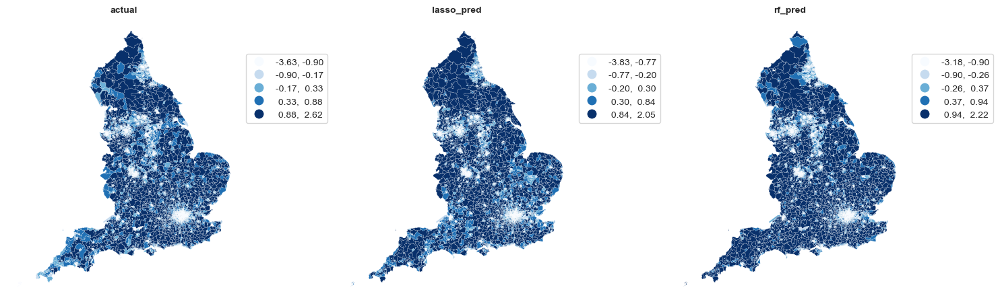

In [ ]:
model_results= gpd.GeoDataFrame(model_results, geometry='geometry')
p_vars= ['actual','lasso_pred','rf_pred']

         
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec

n_plots = len(p_vars)
# compute the number of rows and columns
n_cols =  3#int(np.sqrt(n_plots))
n_rows = int(np.ceil(n_plots / n_cols))

# setup the plot
gs = gridspec.GridSpec(n_rows, n_cols)
scale = max(n_cols, n_rows)
fig = plt.figure(figsize=(5 * scale, 5 * scale))

# loop through each subplot and plot values there
for i in range(n_plots):
    ax = fig.add_subplot(gs[i])
    model_results.plot(column = p_vars[i],ax=ax,legend=True,legend_kwds={'loc': 'center left', 'bbox_to_anchor':(1,0.5,0.5, 0.5),'fmt':"{:.2f}",'fontsize':'small'}, scheme='quantiles', cmap='Blues', linewidth=0.1,)
    ax.set_title(p_vars[i], fontdict={'fontsize': 10, 'fontweight': 'bold'})
    ax.axis('off')
gs.tight_layout(fig, rect=[0, 0, 1.0, 1.0])

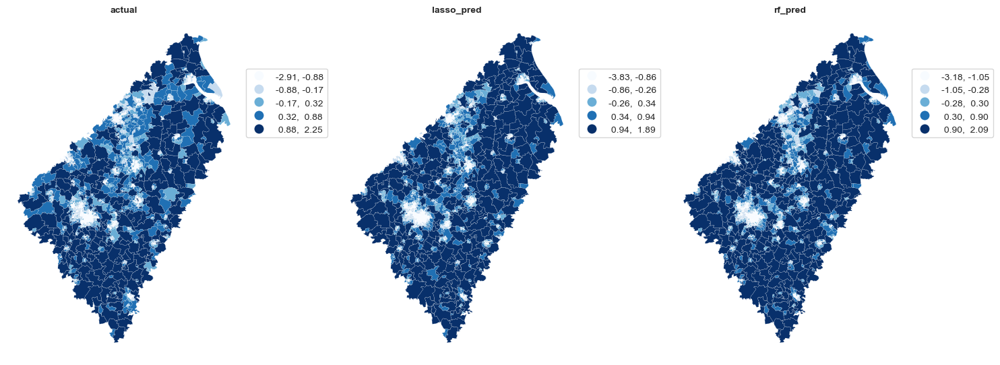

In [ ]:
model_results= gpd.GeoDataFrame(model_results, geometry='geometry')
clust_0 = model_results[model_results['ClusterNo']=='0']
p_vars= ['actual','lasso_pred','rf_pred']

         
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec

n_plots = len(p_vars)
# compute the number of rows and columns
n_cols =  3#int(np.sqrt(n_plots))
n_rows = int(np.ceil(n_plots / n_cols))

# setup the plot
gs = gridspec.GridSpec(n_rows, n_cols)
scale = max(n_cols, n_rows)
fig = plt.figure(figsize=(5 * scale, 5 * scale))

# loop through each subplot and plot values there
for i in range(n_plots):
    ax = fig.add_subplot(gs[i])
    clust_0.plot(column = p_vars[i],ax=ax,legend=True,legend_kwds={'loc': 'center left', 'bbox_to_anchor':(1,0.5,0.5, 0.5),'fmt':"{:.2f}",'fontsize':'small'}, scheme='quantiles', cmap='Blues', linewidth=0.1,)
    ax.set_title(p_vars[i], fontdict={'fontsize': 10, 'fontweight': 'bold'})
    ax.axis('off')
gs.tight_layout(fig, rect=[0, 0, 1.0, 1.0])

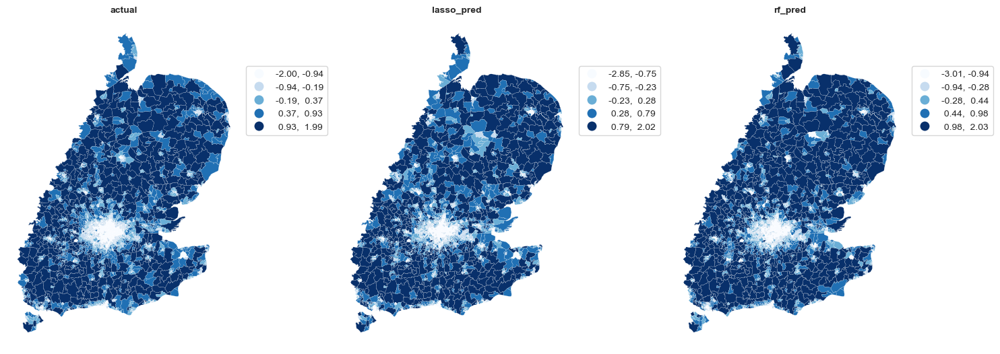

In [ ]:
model_results = gpd.GeoDataFrame(model_results, geometry='geometry')
clust_1 = model_results[model_results['ClusterNo']=='1']
p_vars= ['actual','lasso_pred','rf_pred']

         
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec

n_plots = len(p_vars)
# compute the number of rows and columns
n_cols =  3#int(np.sqrt(n_plots))
n_rows = int(np.ceil(n_plots / n_cols))

# setup the plot
gs = gridspec.GridSpec(n_rows, n_cols)
scale = max(n_cols, n_rows)
fig = plt.figure(figsize=(5 * scale, 5 * scale))

# loop through each subplot and plot values there
for i in range(n_plots):
    ax = fig.add_subplot(gs[i])
    clust_1.plot(column = p_vars[i],ax=ax,legend=True,legend_kwds={'loc': 'center left', 'bbox_to_anchor':(1,0.5,0.5, 0.5),'fmt':"{:.2f}",'fontsize':'small'}, scheme='quantiles', cmap='Blues', linewidth=0.1,)
    ax.set_title(p_vars[i], fontdict={'fontsize': 10, 'fontweight': 'bold'})
    ax.axis('off')
gs.tight_layout(fig, rect=[0, 0, 1.0, 1.0])

### For Cluster 2 or Second Fold we isolate London to quantify which model performs better, we zoom into London

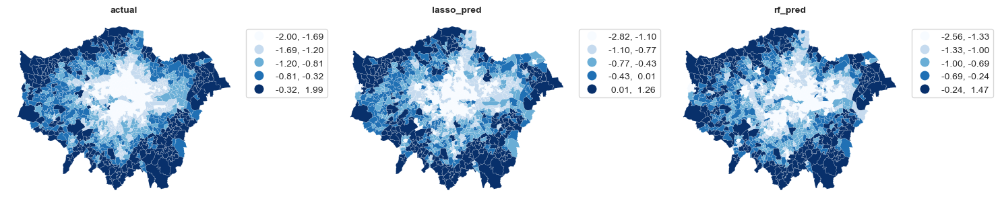

In [ ]:

MSOA_London = pd.read_excel('MSOA London.xlsx') #read excel file to join and isolate area for London to zoom in Cluster 2
London = pd.merge(MSOA_London,model_results,how='inner',left_on = 'MSOA Code',right_on ='MSOA11CD')
London  = gpd.GeoDataFrame(London, geometry='geometry')
p_vars= ['actual','lasso_pred','rf_pred']

         
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec

n_plots = len(p_vars)
# compute the number of rows and columns
n_cols =  3#int(np.sqrt(n_plots))
n_rows = int(np.ceil(n_plots / n_cols))

# setup the plot
gs = gridspec.GridSpec(n_rows, n_cols)
scale = max(n_cols, n_rows)
fig = plt.figure(figsize=(5 * scale, 5 * scale))

# loop through each subplot and plot values there
for i in range(n_plots):
    ax = fig.add_subplot(gs[i])
    London.plot(column = p_vars[i],ax=ax,legend=True,legend_kwds={'loc': 'center left', 'bbox_to_anchor':(1,0.5,0.5, 0.5),'fmt':"{:.2f}",'fontsize':'small'}, scheme='quantiles', cmap='Blues', linewidth=0.1,)
    ax.set_title(p_vars[i], fontdict={'fontsize': 10, 'fontweight': 'bold'})
    ax.axis('off')
gs.tight_layout(fig, rect=[0, 0, 1.0, 1.0])

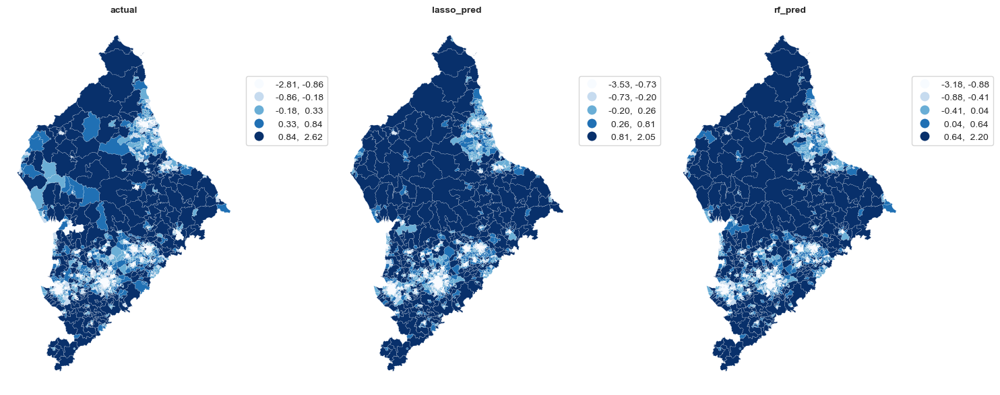

In [ ]:
model_results = gpd.GeoDataFrame(model_results, geometry='geometry')
clust_2 = model_results[model_results['ClusterNo']=='2']
p_vars= ['actual','lasso_pred','rf_pred']

         
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec

n_plots = len(p_vars)
# compute the number of rows and columns
n_cols =  3#int(np.sqrt(n_plots))
n_rows = int(np.ceil(n_plots / n_cols))

# setup the plot
gs = gridspec.GridSpec(n_rows, n_cols)
scale = max(n_cols, n_rows)
fig = plt.figure(figsize=(5 * scale, 5 * scale))

# loop through each subplot and plot values there
for i in range(n_plots):
    ax = fig.add_subplot(gs[i])
    clust_2.plot(column = p_vars[i],ax=ax,legend=True,legend_kwds={'loc': 'center left', 'bbox_to_anchor':(1,0.5,0.5, 0.5),'fmt':"{:.2f}",'fontsize':'small'}, scheme='quantiles', cmap='Blues', linewidth=0.1,)
    ax.set_title(p_vars[i], fontdict={'fontsize': 10, 'fontweight': 'bold'})
    ax.axis('off')
gs.tight_layout(fig, rect=[0, 0, 1.0, 1.0])

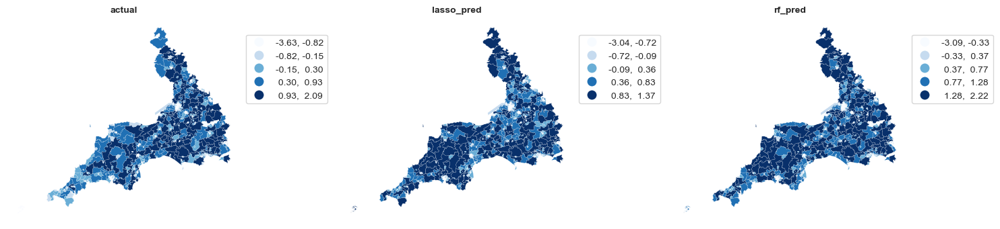

In [ ]:
model_results = gpd.GeoDataFrame(model_results, geometry='geometry')
clust_3 = model_results[model_results['ClusterNo']=='3']
p_vars= ['actual','lasso_pred','rf_pred']

         
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec

n_plots = len(p_vars)
# compute the number of rows and columns
n_cols =  3#int(np.sqrt(n_plots))
n_rows = int(np.ceil(n_plots / n_cols))

# setup the plot
gs = gridspec.GridSpec(n_rows, n_cols)
scale = max(n_cols, n_rows)
fig = plt.figure(figsize=(5 * scale, 5 * scale))

# loop through each subplot and plot values there
for i in range(n_plots):
    ax = fig.add_subplot(gs[i])
    clust_3.plot(column = p_vars[i],ax=ax,legend=True,legend_kwds={'loc': 'center left', 'bbox_to_anchor':(1,0.5,0.5, 0.5),'fmt':"{:.2f}",'fontsize':'small'}, scheme='quantiles', cmap='Blues', linewidth=0.1,)
    ax.set_title(p_vars[i], fontdict={'fontsize': 10, 'fontweight': 'bold'})
    ax.axis('off')
gs.tight_layout(fig, rect=[0, 0, 1.0, 1.0])

## Appendix: Own Notes